## *Importing Libraries

In [2]:
# Libraries for data manipulation, numerical computations, and visualization
import pandas as pd  # Load and manipulate datasets
import numpy as np  # Perform numerical operations on arrays and matrices
import seaborn as sns  # Create statistical data visualizations
import matplotlib.pyplot as plt  # Generate static plots and visualizations

# Tools for customizing visualizations
import matplotlib.lines as lines  # Add custom lines to matplotlib visualizations
import matplotlib.colors as mcolors  # Define and apply custom colormaps to plots

# Machine learning and deep learning library
import tensorflow as tf  # Develop and train machine learning and deep learning models

# Automated exploratory data analysis (EDA)
from ydata_profiling import ProfileReport  # Generate detailed and automated EDA reports

# Data preprocessing tools
from sklearn.compose import ColumnTransformer  # Apply specific transformations to subsets of features
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, StandardScaler  # Encode categorical data and scale features

# Tools for splitting data and handling imbalance
from sklearn.model_selection import train_test_split  # Split datasets into training and testing sets
from imblearn.over_sampling import SMOTE  # Balance datasets by creating synthetic samples

# Machine learning classifiers
from sklearn.linear_model import LogisticRegression  # Apply logistic regression for binary classification
from sklearn.svm import SVC  # Support Vector Classifier for classification tasks
from sklearn.naive_bayes import GaussianNB  # Apply the Naive Bayes algorithm
from sklearn.tree import DecisionTreeClassifier  # Decision tree-based classification
from sklearn.ensemble import RandomForestClassifier  # Ensemble classifier using multiple decision trees
from xgboost import XGBClassifier  # Gradient boosting classifier for improved accuracy

# Metrics for model evaluation
from sklearn.metrics import (
    accuracy_score,  # Calculate classification accuracy
    confusion_matrix,  # Display confusion matrix
    roc_auc_score,  # Compute AUC-ROC score for binary classifiers
    precision_score,  # Measure model precision
    recall_score,  # Measure model recall
    f1_score,  # Compute the F1 score (harmonic mean of precision and recall)
    classification_report,  # Generate a detailed classification report
    roc_curve,  # Plot ROC curve for visual performance evaluation
    auc,  # Compute Area Under the Curve (AUC)
    precision_recall_curve,  # Plot precision-recall tradeoff
    average_precision_score  # Calculate average precision score
)

# Tools for cross-validation and hyperparameter optimization
from sklearn.model_selection import cross_val_score, GridSearchCV  # Evaluate models and tune parameters

# Deep learning tools using TensorFlow Keras
from tensorflow.keras.models import Sequential  # Create sequential neural network models
from tensorflow.keras.layers import LSTM, Dense, Dropout, Conv2D, MaxPooling2D, Flatten  # Add various types of layers
from tensorflow.keras.regularizers import l2  # Apply L2 regularization to avoid overfitting
from scikeras.wrappers import KerasClassifier  # Wrap Keras models for compatibility with scikit-learn

# Random number generation
import random  # Generate random numbers, ensuring reproducibility by setting a fixed seed

import pickle  # Serialize objects to save and load models

# Suppress warnings to improve output readability
import warnings
warnings.filterwarnings("ignore")  # Suppress warnings during execution

# 1) OBTAIN

The dataset contains 11 features and one binary target variable. A brief description of the features is provided below:

- **id**: Identification number of the individual.
- **gender**: Gender of the individual.
- **age**: Age of the individual.
- **hypertension**: Health-related parameter indicating whether the person has hypertension.
- **heart_disease**: Health-related parameter indicating whether the person has heart disease.
- **ever_married**: Personal information indicating whether the person is married or not.
- **work_type**: Nature of the workplace.
- **Residence_type**: Type of residence of the individual.
- **avg_glucose_level**: Average glucose level in blood for the individual (mg/dL).
- **bmi**: Body mass index of the individual.
- **smoking_status**: Habitual information, indicating the current smoking status of the individual.
- **stroke**: Our <u>target variable</u>, indicating whether the person has suffered a stroke.

## Importing Dataset

In [3]:
# Load the dataset
file_path = "healthcare-dataset-stroke-data.csv"
df = pd.read_csv(file_path)

In [4]:
# Displaying few rows of the DataFrame to get an overview of the data
df

,id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,9046,Male,67.0,0,1,Yes,Private,Urban,228.69,36.6,formerly smoked,1
1,51676,Female,61.0,0,0,Yes,Self-employed,Rural,202.21,NaN,never smoked,1
2,31112,Male,80.0,0,1,Yes,Private,Rural,105.92,32.5,never smoked,1
3,60182,Female,49.0,0,0,Yes,Private,Urban,171.23,34.4,smokes,1
4,1665,Female,79.0,1,0,Yes,Self-employed,Rural,174.12,24.0,never smoked,1
...,...,...,...,...,...,...,...,...,...,...,...,...
5105,18234,Female,80.0,1,0,Yes,Private,Urban,83.75,NaN,never smoked,0
5106,44873,Female,81.0,0,0,Yes,Self-employed,Urban,125.20,40.0,never smoked,0
5107,19723,Female,35.0,0,0,Yes,Self-employed,Rural,82.99,30.6,never smoked,0
5108,37544,Male,51.0,0,0,Yes,Private,Rural,166.29,25.6,formerly smoked,0


In [5]:
# Displaying a concise summary of the DataFrame, including the number of non-null values and data types for each column
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 5110 non-null   int64  
 1   gender             5110 non-null   object 
 2   age                5110 non-null   float64
 3   hypertension       5110 non-null   int64  
 4   heart_disease      5110 non-null   int64  
 5   ever_married       5110 non-null   object 
 6   work_type          5110 non-null   object 
 7   Residence_type     5110 non-null   object 
 8   avg_glucose_level  5110 non-null   float64
 9   bmi                4909 non-null   float64
 10  smoking_status     5110 non-null   object 
 11  stroke             5110 non-null   int64  
dtypes: float64(3), int64(4), object(5)
memory usage: 479.2+ KB


In [6]:
# Checking for missing values in each column and calculating their total counts
df.isnull().sum()

,0
id,0
gender,0
age,0
hypertension,0
heart_disease,0
ever_married,0
work_type,0
Residence_type,0
avg_glucose_level,0
bmi,201


# 2) SCRUB

## Mean Imputation

In [7]:
# Replacing missing values in the 'bmi' column with the mean value of the column for imputation
df.bmi.replace(to_replace=np.nan, value=df.bmi.mean(), inplace=True)

In [8]:
# Checking for missing values again after imputing the mean in the 'bmi' column
df.isnull().sum()

,0
id,0
gender,0
age,0
hypertension,0
heart_disease,0
ever_married,0
work_type,0
Residence_type,0
avg_glucose_level,0
bmi,0


In [9]:
# Displaying descriptive statistics of the dataset, such as mean, median, standard deviation, min, and max values for numerical columns
df.describe()

,id,age,hypertension,heart_disease,avg_glucose_level,bmi,stroke
count,5110.000000,5110.000000,5110.000000,5110.000000,5110.000000,5110.000000,5110.000000
mean,36517.829354,43.226614,0.097456,0.054012,106.147677,28.893237,0.048728
std,21161.721625,22.612647,0.296607,0.226063,45.283560,7.698018,0.215320
min,67.000000,0.080000,0.000000,0.000000,55.120000,10.300000,0.000000
25%,17741.250000,25.000000,0.000000,0.000000,77.245000,23.800000,0.000000
50%,36932.000000,45.000000,0.000000,0.000000,91.885000,28.400000,0.000000
75%,54682.000000,61.000000,0.000000,0.000000,114.090000,32.800000,0.000000
max,72940.000000,82.000000,1.000000,1.000000,271.740000,97.600000,1.000000


In [10]:
# Calculating the pairwise correlation coefficients between numerical features in the dataset
df.select_dtypes(include=[np.number]).corr()

,id,age,hypertension,heart_disease,avg_glucose_level,bmi,stroke
id,1.000000,0.003538,0.003550,-0.001296,0.001092,0.002999,0.006388
age,0.003538,1.000000,0.276398,0.263796,0.238171,0.325942,0.245257
hypertension,0.003550,0.276398,1.000000,0.108306,0.174474,0.160189,0.127904
heart_disease,-0.001296,0.263796,0.108306,1.000000,0.161857,0.038899,0.134914
avg_glucose_level,0.001092,0.238171,0.174474,0.161857,1.000000,0.168751,0.131945
bmi,0.002999,0.325942,0.160189,0.038899,0.168751,1.000000,0.038947
stroke,0.006388,0.245257,0.127904,0.134914,0.131945,0.038947,1.000000


## Data Type Standardization

In [11]:
# Observing the dataset information before standardization
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 5110 non-null   int64  
 1   gender             5110 non-null   object 
 2   age                5110 non-null   float64
 3   hypertension       5110 non-null   int64  
 4   heart_disease      5110 non-null   int64  
 5   ever_married       5110 non-null   object 
 6   work_type          5110 non-null   object 
 7   Residence_type     5110 non-null   object 
 8   avg_glucose_level  5110 non-null   float64
 9   bmi                5110 non-null   float64
 10  smoking_status     5110 non-null   object 
 11  stroke             5110 non-null   int64  
dtypes: float64(3), int64(4), object(5)
memory usage: 479.2+ KB


In [12]:
# Convert id to string
df['id'] = df['id'].astype(str)

# Standardizing the 'age' column to round up non-whole numbers to the nearest whole number
df['age'] = df['age'].apply(lambda x: np.ceil(x) if x % 1 != 0 else x)

# Convert age to integer if all values are whole numbers
if (df['age'] % 1 == 0).all():
    df['age'] = df['age'].astype(int)

# Convert categorical columns to category
categorical_columns = ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']
df[categorical_columns] = df[categorical_columns].astype('category')

# Convert binary columns to category
binary_columns = ['hypertension', 'heart_disease', 'stroke']
df[binary_columns] = df[binary_columns].astype('category')

In [13]:
# Observing the dataset information after standardization
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   id                 5110 non-null   object  
 1   gender             5110 non-null   category
 2   age                5110 non-null   int64   
 3   hypertension       5110 non-null   category
 4   heart_disease      5110 non-null   category
 5   ever_married       5110 non-null   category
 6   work_type          5110 non-null   category
 7   Residence_type     5110 non-null   category
 8   avg_glucose_level  5110 non-null   float64 
 9   bmi                5110 non-null   float64 
 10  smoking_status     5110 non-null   category
 11  stroke             5110 non-null   category
dtypes: category(8), float64(2), int64(1), object(1)
memory usage: 200.9+ KB


## Naming Convention Optimization

In [14]:
# Renaming all columns to snake_case and lowercase
df.columns = df.columns.str.strip().str.lower().str.replace(" ", "_")

In [15]:
# Observing the dataset information after optimization
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   id                 5110 non-null   object  
 1   gender             5110 non-null   category
 2   age                5110 non-null   int64   
 3   hypertension       5110 non-null   category
 4   heart_disease      5110 non-null   category
 5   ever_married       5110 non-null   category
 6   work_type          5110 non-null   category
 7   residence_type     5110 non-null   category
 8   avg_glucose_level  5110 non-null   float64 
 9   bmi                5110 non-null   float64 
 10  smoking_status     5110 non-null   category
 11  stroke             5110 non-null   category
dtypes: category(8), float64(2), int64(1), object(1)
memory usage: 200.9+ KB


# 3) EXPLORE

## Manual Exploratory Data Analysis (EDA)

### Heatmap Correlation

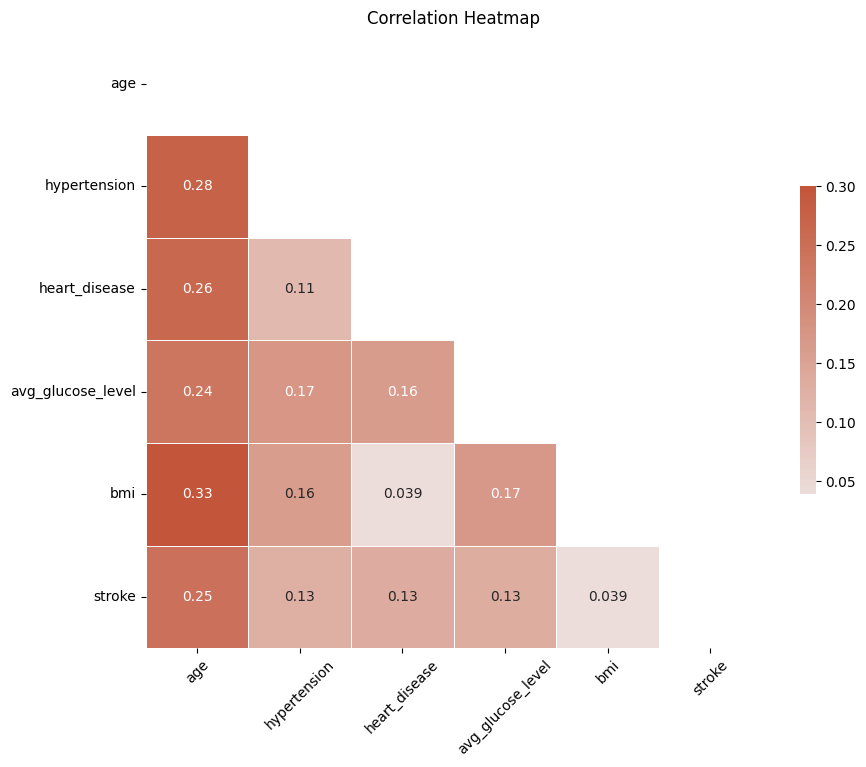

In [16]:
# Identify categorical columns
categorical_cols = df.select_dtypes(include=['category']).columns

# Filter categorical columns that are actually numeric (i.e., can be converted to numbers)
numeric_categorical_cols = [
    col for col in categorical_cols if pd.to_numeric(df[col], errors='coerce').notnull().all()
]

# Combine the numeric categorical columns with the original numeric columns
df_encoded = df.copy()
df_encoded[numeric_categorical_cols] = df_encoded[numeric_categorical_cols].apply(pd.to_numeric, errors='coerce')

# Select only numerical columns for the correlation matrix
df_encoded = df_encoded.select_dtypes(include=[np.number])

# Compute the correlation matrix
corr = df_encoded.corr()

# Generate a mask for the upper triangle of the correlation matrix
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(10, 8))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0, square=True,
            linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

# Rotate the x-ticks for better readability
plt.xticks(rotation=45)

# Set the title for the heatmap
plt.title('Correlation Heatmap')
plt.show()

### Count Plot

Gender Value Counts:
gender
Female    2994
Male      2115
Other        1
Name: count, dtype: int64



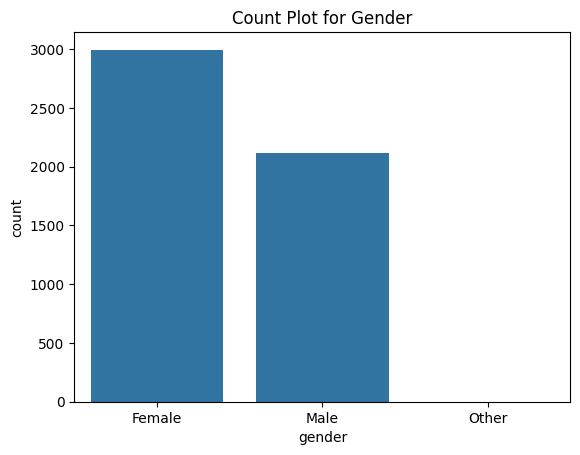

Hypertension Value Counts:
hypertension
0    4612
1     498
Name: count, dtype: int64



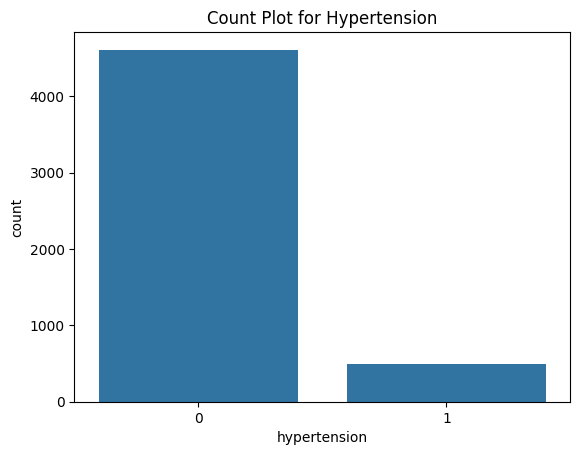

Ever_married Value Counts:
ever_married
Yes    3353
No     1757
Name: count, dtype: int64



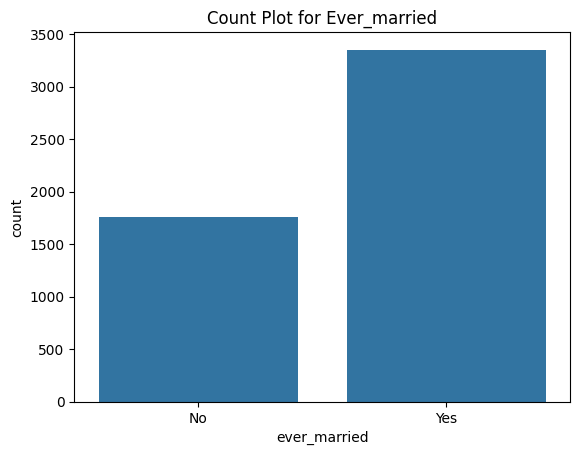

Work_type Value Counts:
work_type
Private          2925
Self-employed     819
children          687
Govt_job          657
Never_worked       22
Name: count, dtype: int64



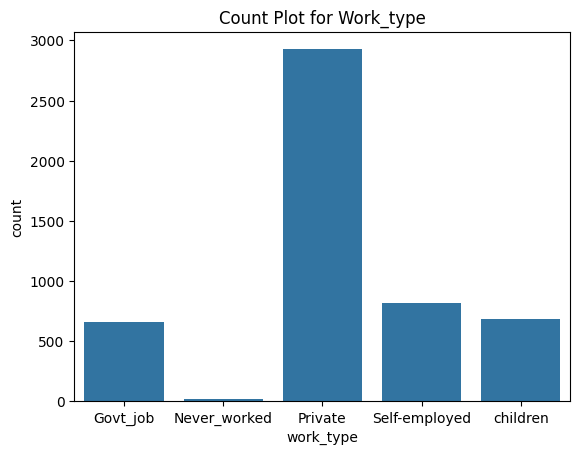

Residence_type Value Counts:
residence_type
Urban    2596
Rural    2514
Name: count, dtype: int64



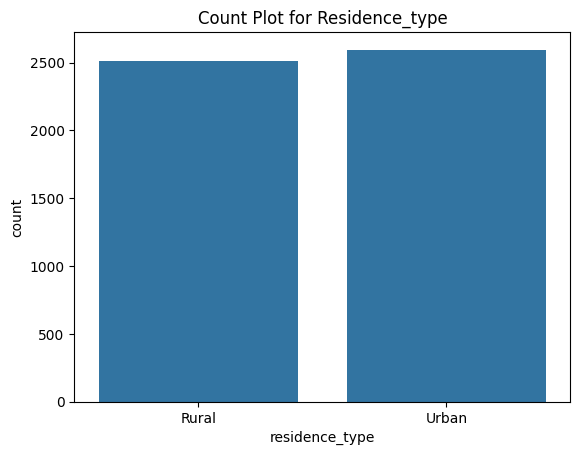

Smoking_status Value Counts:
smoking_status
never smoked       1892
Unknown            1544
formerly smoked     885
smokes              789
Name: count, dtype: int64



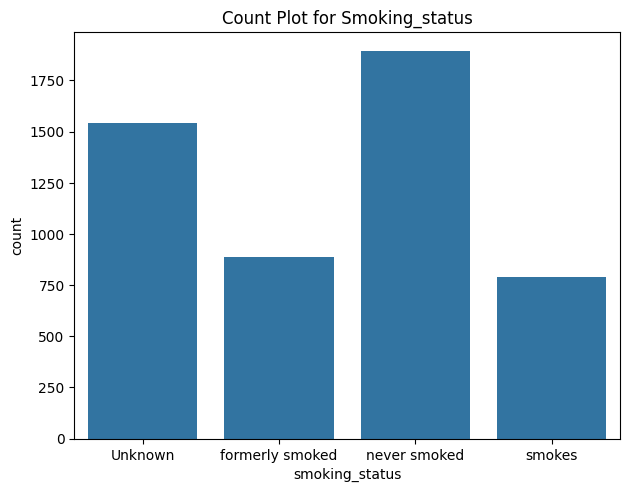

Stroke Value Counts:
stroke
0    4861
1     249
Name: count, dtype: int64



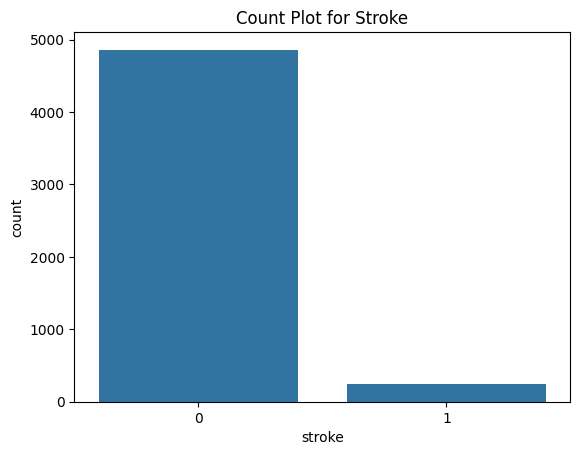

In [17]:
# List of columns to analyze
columns_to_plot = ["gender", "hypertension", "ever_married", "work_type", "residence_type", "smoking_status", "stroke"]

# Loop through each column and perform the required operations
for column in columns_to_plot:
    # Print value counts for the current column
    print(f"{column.capitalize()} Value Counts:")
    print(df[column].value_counts())
    print()

    # Create a count plot for the current column
    ax = sns.countplot(data=df, x=column)

    # Customize plot if needed
    if column == "smoking_status":
        ax.set_xticklabels(ax.get_xticklabels(), fontsize=10)
        plt.tight_layout()

    # Display the plot with a title
    plt.title(f"Count Plot for {column.capitalize()}")
    plt.show()

### Distribution Plot

#### Univariate

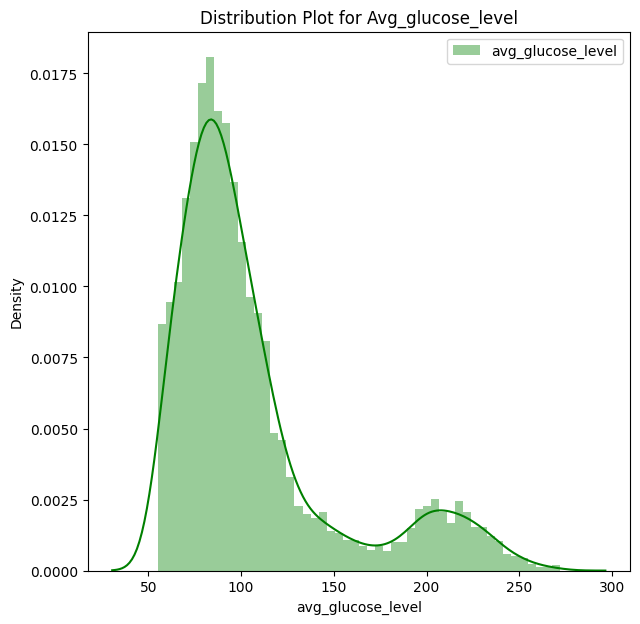

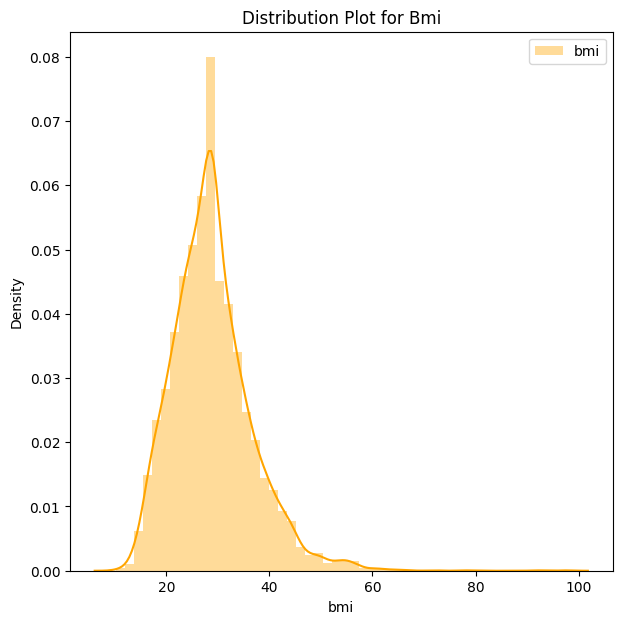

In [18]:
# List of columns to plot distribution
columns_to_plot = ["avg_glucose_level", "bmi"]
colors = ["green", "orange"]

# Loop through each column and plot the distribution
for column, color in zip(columns_to_plot, colors):
    # Create a new figure for each plot
    fig = plt.figure(figsize=(7, 7))

    # Plot the distribution
    sns.distplot(df[column], color=color, label=column, kde=True)

    # Add legend and title
    plt.legend()
    plt.title(f"Distribution Plot for {column.capitalize()}")

    # Show the plot
    plt.show()

#### Multivariate

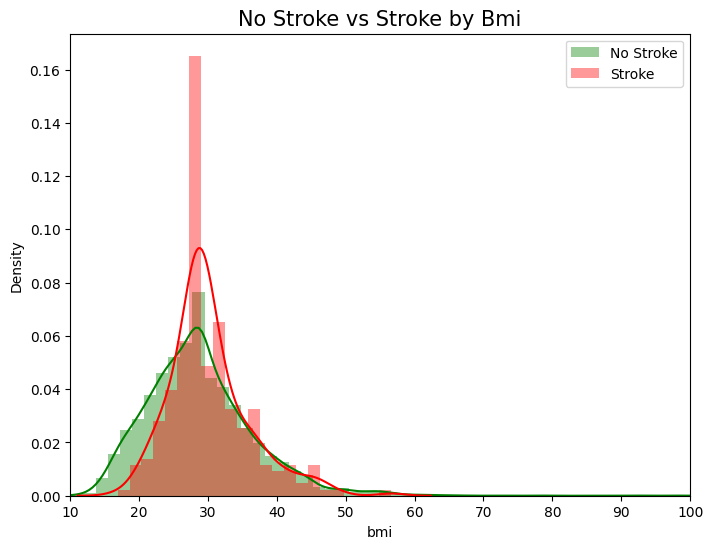

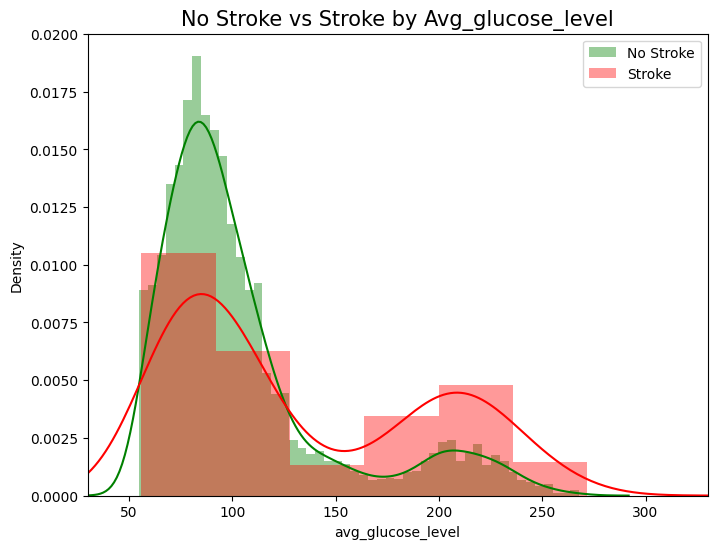

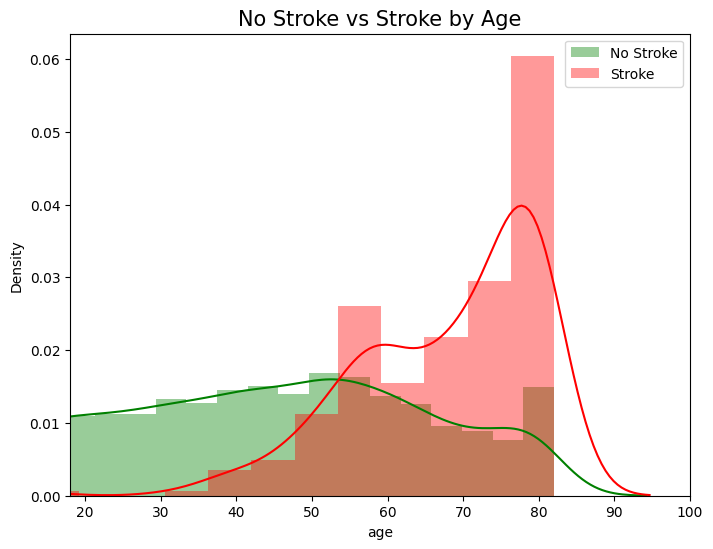

In [19]:
# List of columns to analyze with x-axis limits
columns_to_plot = [("bmi", [10, 100]),
                   ("avg_glucose_level", [30, 330]),
                   ("age", [18, 100])]

# Loop through each column and plot
for column, xlim_range in columns_to_plot:
    plt.figure(figsize=(8, 6))

    # Plot for No Stroke
    sns.distplot(df[df['stroke'] == 0][column], color='green', label='No Stroke')  # Green for No Stroke

    # Plot for Stroke
    sns.distplot(df[df['stroke'] == 1][column], color='red', label='Stroke')  # Red for Stroke

    # Add title and labels
    plt.title(f'No Stroke vs Stroke by {column.capitalize()}', fontsize=15)
    plt.xlim(xlim_range)
    plt.legend()

    # Display the plot
    plt.show()

### Scatter Plot

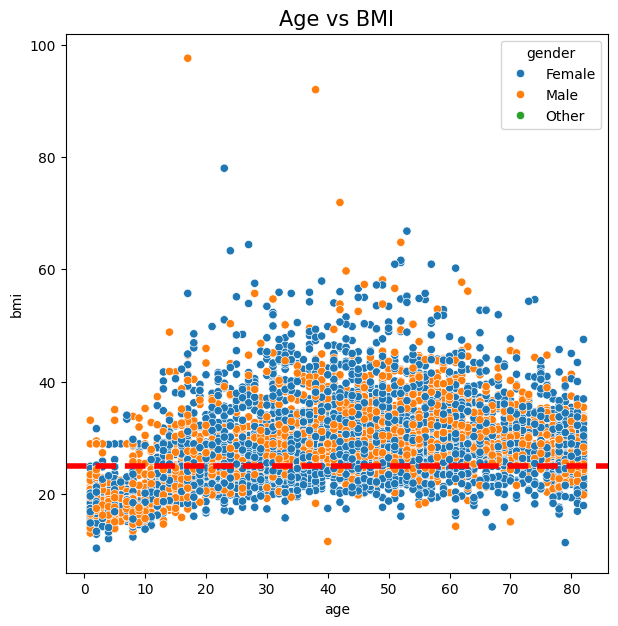

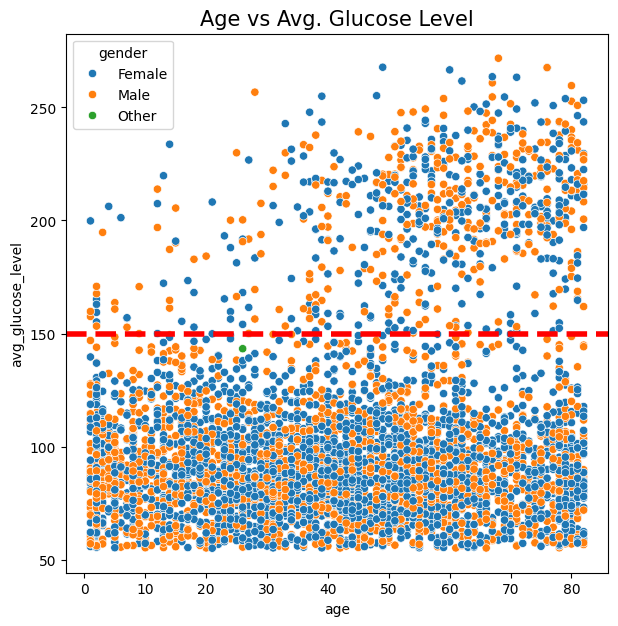

In [20]:
# Define the configurations for scatter plots
scatter_configurations = [
    {
        "x": "age",
        "y": "bmi",
        "hue": "gender",
        "title": "Age vs BMI",
        "axhline_y": 25,  # Reference line for BMI
    },
    {
        "x": "age",
        "y": "avg_glucose_level",
        "hue": "gender",
        "title": "Age vs Avg. Glucose Level",
        "axhline_y": 150,  # Reference line for glucose level
    },
]

# Loop through the configurations to create scatter plots
for config in scatter_configurations:
    # Create the figure
    fig = plt.figure(figsize=(7, 7))

    # Create the scatter plot
    graph = sns.scatterplot(data=df, x=config["x"], y=config["y"], hue=config["hue"])

    # Add a horizontal reference line
    graph.axhline(y=config["axhline_y"], linewidth=4, color='r', linestyle='--')

    # Add title
    plt.title(config["title"], fontsize=15)

    # Display the plot
    plt.show()

### Violin Plot

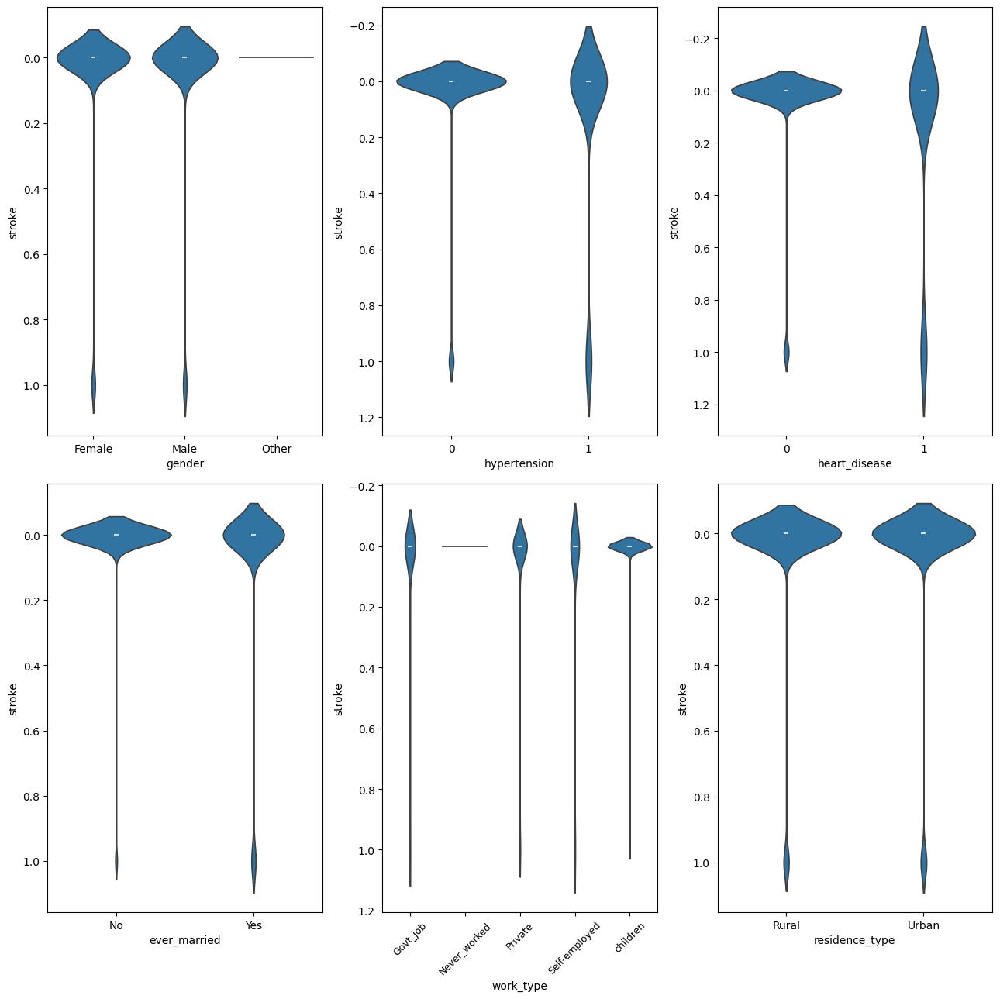

In [21]:
# List of features to plot against 'stroke'
features_to_plot = ["gender", "hypertension", "heart_disease", "ever_married", "work_type", "residence_type"]

# Set the figure size for the violin plots
plt.figure(figsize=(13, 13))

# Loop through the features and create violin plots
for i, feature in enumerate(features_to_plot, start=1):
    # Add a subplot for each feature
    plt.subplot(2, 3, i)

    # Create a violin plot for the current feature against 'stroke'
    sns.violinplot(x=feature, y='stroke', data=df)

    # Customize x-axis ticks for better readability
    if feature == "work_type":
        plt.xticks(fontsize=9, rotation=45)

# Display all the plots
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

### Pair Plot

<Figure size 1000x1000 with 0 Axes>

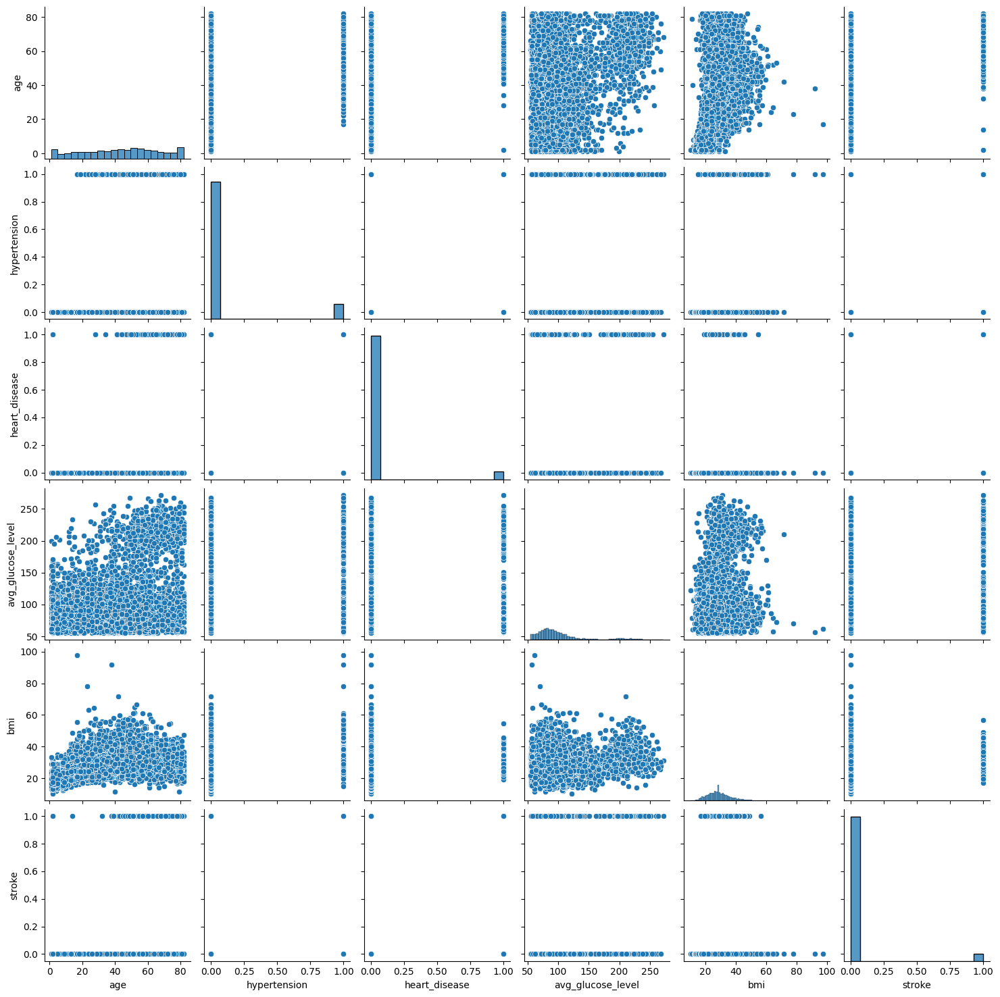

In [22]:
# Identify categorical columns
categorical_cols = df.select_dtypes(include=['category']).columns

# Filter categorical columns that are actually numeric (i.e., can be converted to numbers)
numeric_categorical_cols = [
    col for col in categorical_cols if pd.to_numeric(df[col], errors='coerce').notnull().all()
]

# Combine the numeric categorical columns with the original numeric columns
df_encoded = df.copy()
df_encoded[numeric_categorical_cols] = df_encoded[numeric_categorical_cols].apply(pd.to_numeric, errors='coerce')

# Select only numerical columns for the pair plot
df_pairplot = df_encoded.select_dtypes(include=[np.number])

# Create a figure with specified size
fig = plt.figure(figsize=(10, 10))

# Generate the pair plot (scatter plots for pairwise relationships and histograms for distributions)
sns.pairplot(df_pairplot)

# Show the plot
plt.show()

## Automated EDA

In [23]:
try:
    # Generate the profiling report for the dataframe
    profile = ProfileReport(df, title="Pandas Profiling Report - Stroke Prediction Data", explorative=True)

    # Display the report in Jupyter Notebook (interactive)
    profile.to_notebook_iframe()

    # Save the report as an HTML file for future access
    profile.to_file("stroke_prediction_data_profile_report.html")

    print("Profiling report generated successfully.")
except Exception as e:
    print(f"An error occurred: {e}")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profiling report generated successfully.


# 4) MODEL

## Feature Engineering

In [24]:
# Selecting the features (input variables) - excluding 'id' and 'stroke' columns
x = df.iloc[:, 1:-1].values  # Features - all columns except 'id' (index 0) and 'stroke' (target column)

# Selecting the target variable (output variable) - 'stroke'
y = df.iloc[:, -1].values  # Target variable (the last column, 'stroke')

In [25]:
# Display the features (x)
x  # The 'x' variable contains the feature data

array([['Male', 67, 0, ..., 228.69, 36.6, 'formerly smoked'],
       ['Female', 61, 0, ..., 202.21, 28.893236911794666, 'never smoked'],
       ['Male', 80, 0, ..., 105.92, 32.5, 'never smoked'],
       ...,
       ['Female', 35, 0, ..., 82.99, 30.6, 'never smoked'],
       ['Male', 51, 0, ..., 166.29, 25.6, 'formerly smoked'],
       ['Female', 44, 0, ..., 85.28, 26.2, 'Unknown']], dtype=object)

In [26]:
# Display the target variable (y)
y  # The 'y' variable contains the target data

[1, 1, 1, 1, 1, ..., 0, 0, 0, 0, 0]
Length: 5110
Categories (2, int64): [0, 1]

### Categorical Encoding

In [27]:
# Initialize the ColumnTransformer with OneHotEncoder for categorical columns
# The encoder is applied to columns at indices 0, 5, and 9 (gender, work_type, and smoking_status)
# Remainder: 'passthrough' ensures the other columns are left unchanged (i.e., columns not in [0,5,9])
ct = ColumnTransformer(transformers=[('encoder', OneHotEncoder(), [0, 5, 9])], remainder='passthrough')

# Applying the ColumnTransformer to the feature data 'x' to encode categorical variables
x = np.array(ct.fit_transform(x))  # 'x' now contains the transformed data with encoded categorical variables

In [28]:
# Display the transformed feature data
x  # The transformed 'x' with one-hot encoding applied

array([[0.0, 1.0, 0.0, ..., 'Urban', 228.69, 36.6],
       [1.0, 0.0, 0.0, ..., 'Rural', 202.21, 28.893236911794666],
       [0.0, 1.0, 0.0, ..., 'Rural', 105.92, 32.5],
       ...,
       [1.0, 0.0, 0.0, ..., 'Rural', 82.99, 30.6],
       [0.0, 1.0, 0.0, ..., 'Rural', 166.29, 25.6],
       [1.0, 0.0, 0.0, ..., 'Urban', 85.28, 26.2]], dtype=object)

### Label Encoding (Binary)

In [29]:
# Initialize two separate LabelEncoders
le1 = LabelEncoder()  # Encoder for the 'ever_married' column
le2 = LabelEncoder()  # Encoder for the 'residence_type' column

# Apply LabelEncoder to the 15th column (index 15) of the feature set 'x' (This column should be binary)
# 'ever_married' column
x[:, 15] = le1.fit_transform(x[:, 15])

# Apply LabelEncoder to the 16th column (index 16) of the feature set 'x' (This column should also be binary)
# 'residence_type' column
x[:, 16] = le2.fit_transform(x[:, 16])

In [30]:
# Display the transformed feature data after Label Encoding
x  # The transformed 'x' with label encoding applied to specific columns

array([[0.0, 1.0, 0.0, ..., 1, 228.69, 36.6],
       [1.0, 0.0, 0.0, ..., 0, 202.21, 28.893236911794666],
       [0.0, 1.0, 0.0, ..., 0, 105.92, 32.5],
       ...,
       [1.0, 0.0, 0.0, ..., 0, 82.99, 30.6],
       [0.0, 1.0, 0.0, ..., 0, 166.29, 25.6],
       [1.0, 0.0, 0.0, ..., 1, 85.28, 26.2]], dtype=object)

In [31]:
# Print the shapes of the feature set (x) and the target variable (y)
print('Shape of X: ', x.shape)  # This shows the dimensions of the feature set 'x'
print('Shape of Y: ', y.shape)  # This shows the dimensions of the target variable 'y'

Shape of X:  (5110, 19)
Shape of Y:  (5110,)


## Train-Test Splitting

In [32]:
# Splitting the dataset into training and testing sets
# x: features, y: labels
# test_size=0.2 means 20% of the data will be used for testing, and the remaining 80% will be for training
# random_state=0 ensures the split is reproducible across different runs
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size= 0.2, random_state= 42)

In [33]:
# Displaying the shape of the train and test sets to verify the split
print("Number of transactions in x_train dataset: ", x_train.shape)
print("Number of transactions in y_train dataset: ", y_train.shape)
print("Number of transactions in x_test dataset: ", x_test.shape)
print("Number of transactions in y_test dataset: ", y_test.shape)

Number of transactions in x_train dataset:  (4088, 19)
Number of transactions in y_train dataset:  (4088,)
Number of transactions in x_test dataset:  (1022, 19)
Number of transactions in y_test dataset:  (1022,)


## Feature Scaling

In [34]:
x_train, x_test

(array([[0.0, 1.0, 0.0, ..., 0, 112.64, 28.5],
        [1.0, 0.0, 0.0, ..., 1, 88.32, 36.3],
        [1.0, 0.0, 0.0, ..., 0, 59.52, 33.7],
        ...,
        [1.0, 0.0, 0.0, ..., 1, 97.28, 17.8],
        [0.0, 1.0, 0.0, ..., 0, 196.08, 31.0],
        [1.0, 0.0, 0.0, ..., 0, 100.15, 50.3]], dtype=object),
 array([[0.0, 1.0, 0.0, ..., 0, 64.85, 23.0],
        [0.0, 1.0, 0.0, ..., 0, 65.29, 28.3],
        [1.0, 0.0, 0.0, ..., 1, 74.42, 22.5],
        ...,
        [0.0, 1.0, 0.0, ..., 0, 119.3, 30.4],
        [1.0, 0.0, 0.0, ..., 1, 128.63, 24.9],
        [0.0, 1.0, 0.0, ..., 0, 106.41, 27.3]], dtype=object))

In [35]:
# Initializing StandardScaler to scale the features
sc = StandardScaler()

# Fitting the scaler to the training data and transforming it
# Scaling is done to ensure that the features have zero mean and unit variance
x_train = sc.fit_transform(x_train)

# Transforming the test set based on the statistics (mean, variance) of the training set
# The test data is scaled using the same parameters as the training data
x_test = sc.transform(x_test)

In [36]:
x_train, x_test

(array([[-1.19299477,  1.19299477,  0.        , ..., -1.02326468,
          0.13559307, -0.05801609],
        [ 0.83822664, -0.83822664,  0.        , ...,  0.97726426,
         -0.39745713,  0.94746229],
        [ 0.83822664, -0.83822664,  0.        , ..., -1.02326468,
         -1.02870079,  0.61230283],
        ...,
        [ 0.83822664, -0.83822664,  0.        , ...,  0.97726426,
         -0.20107021, -1.43732618],
        [-1.19299477,  1.19299477,  0.        , ..., -1.02326468,
          1.96444623,  0.26425262],
        [ 0.83822664, -0.83822664,  0.        , ..., -1.02326468,
         -0.13816503,  2.75216707]]),
 array([[-1.19299477e+00,  1.19299477e+00,  0.00000000e+00, ...,
         -1.02326468e+00, -9.11876874e-01, -7.67007258e-01],
        [-1.19299477e+00,  1.19299477e+00,  0.00000000e+00, ...,
         -1.02326468e+00, -9.02232874e-01, -8.37975893e-02],
        [ 8.38226644e-01, -8.38226644e-01,  0.00000000e+00, ...,
          9.77264259e-01, -7.02119867e-01, -8.31461000e-

## Data Resampling (SMOTE)

Before OverSampling, counts of label '1': 187
Before OverSampling, counts of label '0': 3901 



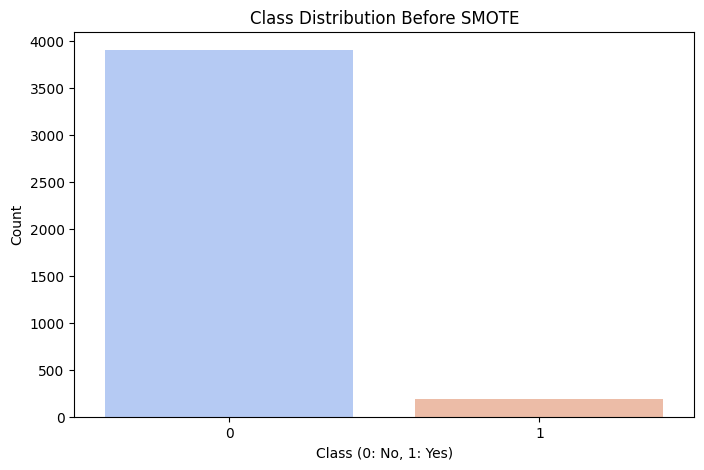

After OverSampling, counts of label '1': 3901
After OverSampling, counts of label '0': 3901


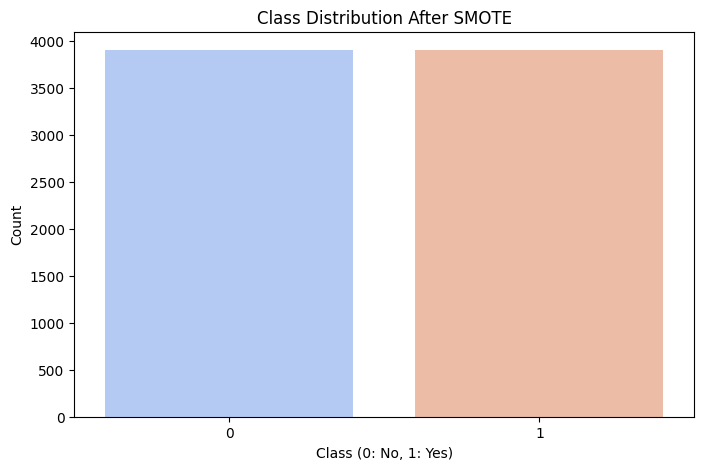

After OverSampling, the shape of train_X: (7802, 19)
After OverSampling, the shape of train_y: (7802,) 



In [37]:
# Function to plot the class distribution
def plot_class_distribution(y, title):
    plt.figure(figsize=(8, 5))
    sns.countplot(x=y, palette='coolwarm')
    plt.title(title)
    plt.xlabel('Class (0: No, 1: Yes)')
    plt.ylabel('Count')
    plt.show()

# Displaying the class distribution before applying SMOTE
print("Before OverSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train==0)))

# Plotting the distribution before SMOTE
plot_class_distribution(y_train, "Class Distribution Before SMOTE")

# Initializing SMOTE with random_state=2 to ensure reproducibility of the sampling process
sm = SMOTE(random_state=2)

# Applying SMOTE to the training set to generate synthetic samples for the minority class
x_train_res, y_train_res = sm.fit_resample(x_train, y_train.ravel())

# Displaying the count of each class after applying SMOTE
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res==1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res==0)))

# Plotting the distribution after SMOTE
plot_class_distribution(y_train_res, "Class Distribution After SMOTE")

# Displaying the shape of the newly balanced training set
print('After OverSampling, the shape of train_X: {}'.format(x_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))

## Model Building

In [38]:
# Defining the list of models for training and evaluation
models = [
    ['Logistic Regression', LogisticRegression(random_state=0)],  # Logistic Regression
    ['Support Vector Machine', SVC(random_state=0)],  # Support Vector Classifier
    ['Naive Bayes', GaussianNB()],  # Naive Bayes
    ['Decision Tree Classifier', DecisionTreeClassifier(random_state=0)],  # Decision Tree Classifier
    ['Random Forest Classifier', RandomForestClassifier(random_state=0)],  # Random Forest Classifier
    ['XGBoost Classifier', XGBClassifier(eval_metric='error')]  # XGBoost Classifier
]

# Initialize an empty list to store results for each model
results = []

# Loop through each model in the list
for model_name, model in models:
    print(f"Training {model_name}...")

    # Training the model with the resampled training data
    model.fit(x_train_res, y_train_res)

    # Making predictions on the test set
    y_pred = model.predict(x_test)

    # Generating the confusion matrix
    cm = confusion_matrix(y_test, y_pred)

    # Performing K-fold cross-validation to calculate the model's accuracy
    accuracies = cross_val_score(estimator=model, X=x_train_res, y=y_train_res, cv=10)

    # Calculating various evaluation metrics
    roc = roc_auc_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    # Printing model performance metrics
    print(f"Confusion Matrix for {model_name}:")
    print(cm)
    print(f"Accuracy Score: {accuracy_score(y_test, y_pred)}")
    print(f"K-Fold Validation Mean Accuracy: {accuracies.mean() * 100:.2f}%")
    print(f"Standard Deviation: {accuracies.std() * 100:.2f}%")
    print(f"ROC AUC Score: {roc:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1 Score: {f1:.2f}")
    print("-" * 40)
    print("")  # Add a line for better readability

    # Store model evaluation results in a list
    results.append([
        model_name,
        accuracy_score(y_test, y_pred) * 100,  # Accuracy as percentage
        accuracies.mean() * 100,  # K-fold mean accuracy
        accuracies.std() * 100,  # Standard deviation of K-fold accuracies
        roc,  # ROC AUC Score
        precision,  # Precision
        recall,  # Recall
        f1  # F1 Score
    ])

# Convert results into a DataFrame for better visualization
results_df = pd.DataFrame(results, columns=[
    'Model',
    'Accuracy (%)',
    'K-Fold Mean Accuracy (%)',
    'K-Fold Std Deviation (%)',
    'ROC AUC Score',
    'Precision',
    'Recall',
    'F1 Score'
])

# Sorting the DataFrame based on 'Accuracy (%)' and 'K-Fold Mean Accuracy (%)' columns in descending order
# The inplace=True parameter ensures the DataFrame is updated directly without creating a new copy
results_df.sort_values(by=['Accuracy (%)', 'K-Fold Mean Accuracy (%)'], inplace=True, ascending=False)

# Displaying the sorted DataFrame to verify the changes and check the ranking of models based on accuracy
results_df

Training Logistic Regression...
Confusion Matrix for Logistic Regression:
[[724 236]
 [ 13  49]]
Accuracy Score: 0.7563600782778865
K-Fold Validation Mean Accuracy: 78.47%
Standard Deviation: 1.68%
ROC AUC Score: 0.77
Precision: 0.17
Recall: 0.79
F1 Score: 0.28
----------------------------------------

Training Support Vector Machine...
Confusion Matrix for Support Vector Machine:
[[793 167]
 [ 34  28]]
Accuracy Score: 0.8033268101761253
K-Fold Validation Mean Accuracy: 88.82%
Standard Deviation: 1.44%
ROC AUC Score: 0.64
Precision: 0.14
Recall: 0.45
F1 Score: 0.22
----------------------------------------

Training Naive Bayes...
Confusion Matrix for Naive Bayes:
[[259 701]
 [  0  62]]
Accuracy Score: 0.31409001956947163
K-Fold Validation Mean Accuracy: 62.77%
Standard Deviation: 0.76%
ROC AUC Score: 0.63
Precision: 0.08
Recall: 1.00
F1 Score: 0.15
----------------------------------------

Training Decision Tree Classifier...
Confusion Matrix for Decision Tree Classifier:
[[861  99]
 [

,Model,Accuracy (%),K-Fold Mean Accuracy (%),K-Fold Std Deviation (%),ROC AUC Score,Precision,Recall,F1 Score
5,XGBoost Classifier,92.074364,95.874848,5.945944,0.512735,0.120000,0.048387,0.068966
4,Random Forest Classifier,91.585127,96.270626,1.698716,0.540306,0.184211,0.112903,0.140000
3,Decision Tree Classifier,85.714286,91.054155,2.045302,0.569405,0.131579,0.241935,0.170455
1,Support Vector Machine,80.332681,88.823845,1.438946,0.638827,0.143590,0.451613,0.217899
0,Logistic Regression,75.636008,78.467514,1.684528,0.772245,0.171930,0.790323,0.282421
2,Naive Bayes,31.409002,62.765898,0.759467,0.634896,0.081258,1.000000,0.150303


## Hyperparameters Tuning

In [39]:
# Define machine learning models with hyperparameter grids
grid_models = [
    # Logistic Regression with regularization parameter 'C' [1]
    (LogisticRegression(), [{'C': [0.25, 0.5, 0.75, 1], 'random_state': [0]}]),

    # Support Vector Classifier (SVC) with regularization parameter 'C' and kernel options [2]
    (SVC(), [{'C': [0.25, 0.5, 0.75, 1], 'kernel': ['linear', 'rbf'], 'random_state': [0]}]),

    # Naive Bayes with smoothing parameter [1*]
    (GaussianNB(), [{'var_smoothing': [1e-09]}]),

    # Decision Tree Classifier with splitting criteria options [1]
    (DecisionTreeClassifier(), [{'criterion': ['gini', 'entropy'], 'random_state': [0]}]),

    # Random Forest Classifier with number of estimators and splitting criteria [2]
    (RandomForestClassifier(), [{'n_estimators': [100, 150, 200], 'criterion': ['gini', 'entropy'], 'random_state': [0]}]),

    # XGBoost Classifier with learning rate and evaluation metric [1+1*]
    (XGBClassifier(), [{'learning_rate': [0.01, 0.05, 0.1], 'eval_metric': ['error']}])
]

# Iterate through the models and perform grid search
for model, params in grid_models:
    # Set up GridSearchCV for hyperparameter tuning
    grid = GridSearchCV(estimator=model, param_grid=params, scoring='accuracy', cv=10)

    # Train the model with training data
    grid.fit(x_train_res, y_train_res)

    # Extract the best accuracy and hyperparameters
    best_accuracy = grid.best_score_ * 100  # Convert to percentage
    best_params = grid.best_params_

    # Print the results for the current model
    print(f"Model: {model.__class__.__name__}")
    print(f"Best Accuracy: {best_accuracy:.2f}%")
    print(f"Best Parameters: {best_params}")
    print("-" * 30)

Model: LogisticRegression
Best Accuracy: 78.51%
Best Parameters: {'C': 0.25, 'random_state': 0}
------------------------------
Model: SVC
Best Accuracy: 88.82%
Best Parameters: {'C': 1, 'kernel': 'rbf', 'random_state': 0}
------------------------------
Model: GaussianNB
Best Accuracy: 62.77%
Best Parameters: {'var_smoothing': 1e-09}
------------------------------
Model: DecisionTreeClassifier
Best Accuracy: 91.80%
Best Parameters: {'criterion': 'entropy', 'random_state': 0}
------------------------------
Model: RandomForestClassifier
Best Accuracy: 96.27%
Best Parameters: {'criterion': 'gini', 'n_estimators': 100, 'random_state': 0}
------------------------------
Model: XGBClassifier
Best Accuracy: 94.34%
Best Parameters: {'eval_metric': 'error', 'learning_rate': 0.1}
------------------------------


## RF and XGBoost Training with Best Hyperparameters

### Random Forest (RF)

In [40]:
# Initialize and fit the RandomForest model
classifier_rf = RandomForestClassifier(criterion='gini', n_estimators=100, random_state=0)  # Set up RandomForest with Gini index
classifier_rf.fit(x_train_res, y_train_res)  # Train the model with reshaped training data

# Make predictions and calculate probabilities
y_pred_rf = classifier_rf.predict(x_train)  # Predict class labels
y_prob_rf = classifier_rf.predict_proba(x_train)[:, 1]  # Get predicted probabilities for the positive class

# Generate confusion matrix
cm_rf = confusion_matrix(y_train, y_pred_rf)  # Calculate confusion matrix to evaluate performance

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3901
           1       1.00      1.00      1.00       187

    accuracy                           1.00      4088
   macro avg       1.00      1.00      1.00      4088
weighted avg       1.00      1.00      1.00      4088

ROC AUC score: 1.0
Accuracy Score:  1.0


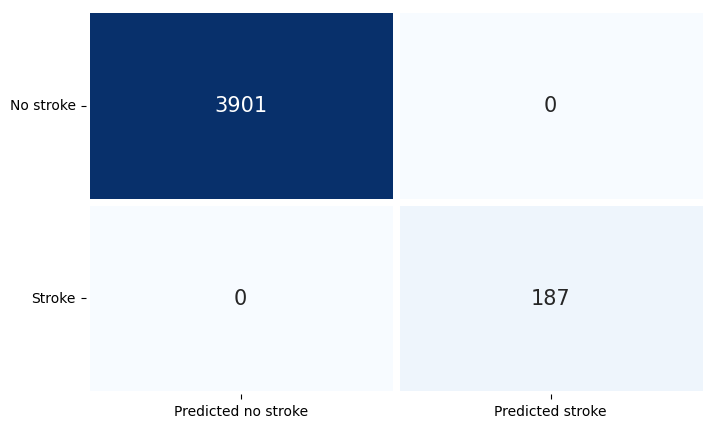

In [41]:
# Print classification report to evaluate model performance with precision, recall, f1-score
print(classification_report(y_train, y_pred_rf))

# Print ROC AUC score for evaluating the model's ability to distinguish between classes
print(f'ROC AUC score: {roc_auc_score(y_train, y_prob_rf)}')

# Print accuracy score for overall performance measurement
print('Accuracy Score: ', accuracy_score(y_train, y_pred_rf))

# Visualize the confusion matrix as a heatmap to understand model performance
plt.figure(figsize=(8, 5))  # Set figure size for the plot
sns.heatmap(cm_rf, cmap='Blues', annot=True, fmt='d', linewidths=5, cbar=False, annot_kws={'fontsize': 15},
            yticklabels=['No stroke', 'Stroke'], xticklabels=['Predicted no stroke', 'Predicted stroke'])
plt.yticks(rotation=0)  # Rotate y-axis labels
plt.show()  # Display the confusion matrix plot

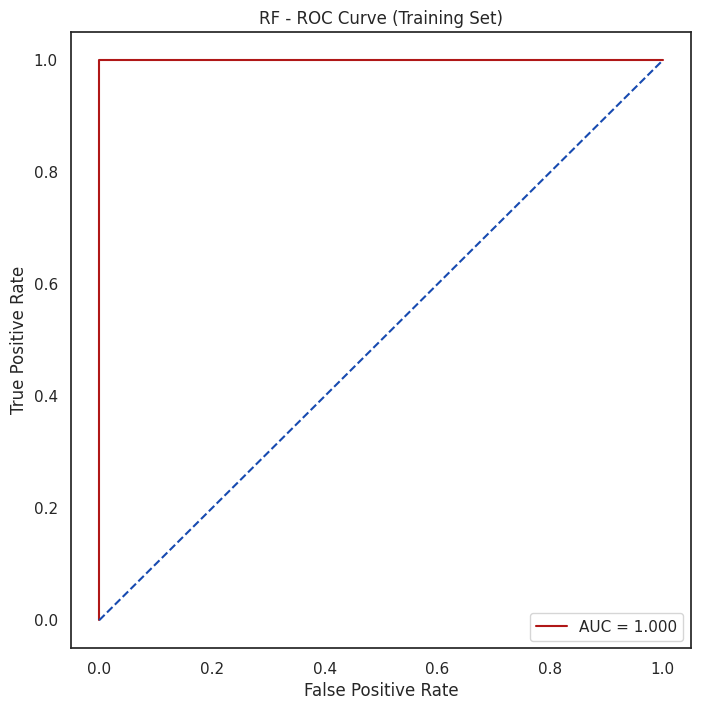

In [42]:
# Plot the ROC AUC curve for evaluating model performance across different thresholds
false_positive_rate_rf, true_positive_rate_rf, thresholds = roc_curve(y_train, y_prob_rf)  # Compute ROC curve values
roc_auc_rf = auc(false_positive_rate_rf, true_positive_rate_rf)  # Calculate the AUC score for the ROC curve

# Set the theme for the plot using Seaborn
sns.set_theme(style='white')

# Initialize the plot with a specified figure size
plt.figure(figsize=(8, 8))

# Plot the ROC curve for the Random Forest model, showing AUC score in the legend
plt.plot(false_positive_rate_rf, true_positive_rate_rf, color='#b01717', label='AUC = %0.3f' % roc_auc_rf)

# Add a legend to the plot at the bottom-right corner
plt.legend(loc='lower right')

# Plot a diagonal line representing a random classifier (AUC = 0.5)
plt.plot([0, 1], [0, 1], linestyle='--', color='#174ab0')

# Set the axis limits for a tight fit around the curve
plt.axis('tight')

# Set the title, x-axis label, and y-axis label for the plot
plt.title('RF - ROC Curve (Training Set)')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')

# Display the plot with all elements
plt.legend()
plt.show()

### Extreme Gradient Boosting (XGBoost)

In [43]:
# Initialize and fit the XGBoost model
classifier_xgb = XGBClassifier(eval_metric='error', learning_rate=0.1)  # Set up XGBoost with error as evaluation metric and learning rate of 0.1
classifier_xgb.fit(x_train_res, y_train_res)  # Train the model with reshaped training data

# Make predictions and calculate probabilities
y_pred_xgb = classifier_xgb.predict(x_train)  # Predict class labels
y_prob_xgb = classifier_xgb.predict_proba(x_train)[:, 1]  # Get predicted probabilities for the positive class

# Generate confusion matrix
cm_xgb = confusion_matrix(y_train, y_pred_xgb)  # Calculate confusion matrix to evaluate performance

              precision    recall  f1-score   support

           0       0.99      0.97      0.98      3901
           1       0.51      0.75      0.61       187

    accuracy                           0.96      4088
   macro avg       0.75      0.86      0.79      4088
weighted avg       0.97      0.96      0.96      4088

ROC AUC score: 0.9716938067436431
Accuracy Score:  0.9557240704500979


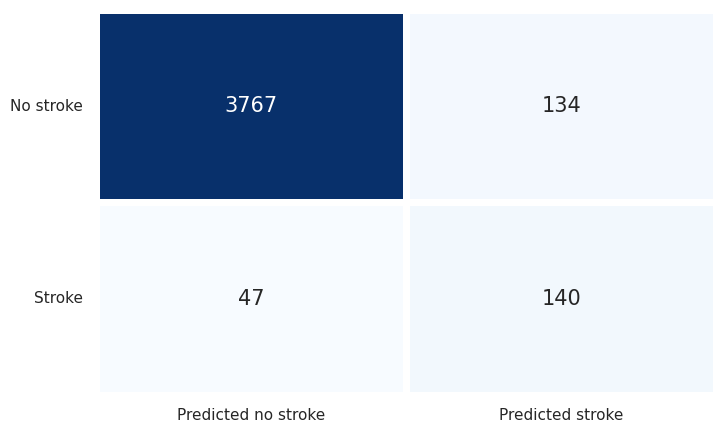

In [44]:
# Print classification report to evaluate XGBoost model performance with precision, recall, f1-score
print(classification_report(y_train, y_pred_xgb))

# Print ROC AUC score for evaluating XGBoost model's ability to distinguish between classes
print(f'ROC AUC score: {roc_auc_score(y_train, y_prob_xgb)}')

# Print accuracy score for overall performance measurement with XGBoost
print('Accuracy Score: ', accuracy_score(y_train, y_pred_xgb))

# Visualize the confusion matrix as a heatmap for XGBoost model performance
plt.figure(figsize=(8, 5))  # Set figure size for the plot
sns.heatmap(cm_xgb, cmap='Blues', annot=True, fmt='d', linewidths=5, cbar=False, annot_kws={'fontsize': 15},
            yticklabels=['No stroke', 'Stroke'], xticklabels=['Predicted no stroke', 'Predicted stroke'])
plt.yticks(rotation=0)  # Rotate y-axis labels
plt.show()  # Display the confusion matrix plot

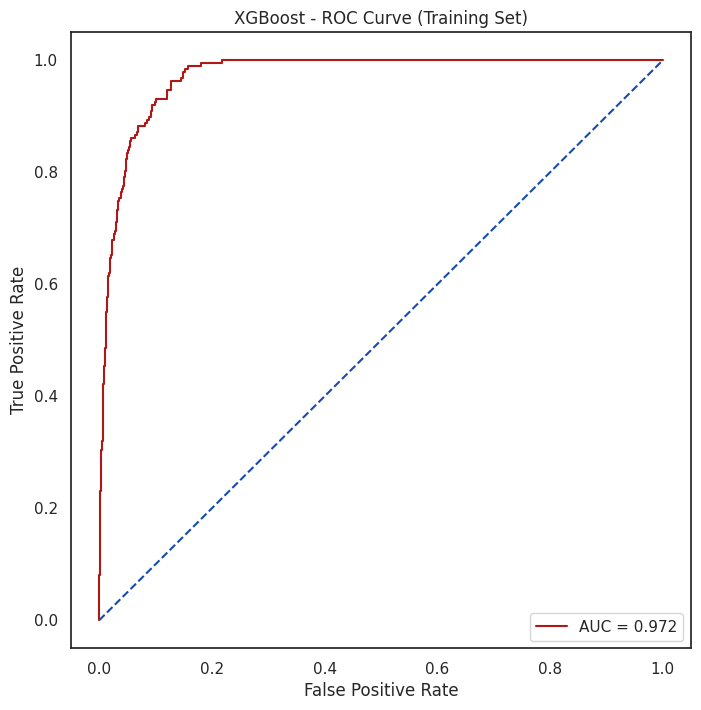

In [45]:
# Plot the ROC AUC curve for evaluating model performance across different thresholds for XGBoost
false_positive_rate_xgb, true_positive_rate_xgb, thresholds = roc_curve(y_train, y_prob_xgb)  # Compute ROC curve values
roc_auc_xgb = auc(false_positive_rate_xgb, true_positive_rate_xgb)  # Calculate the AUC score for the ROC curve

# Set the theme for the plot using Seaborn
sns.set_theme(style='white')

# Initialize the plot with a specified figure size
plt.figure(figsize=(8, 8))

# Plot the ROC curve for the XGBoost model, showing AUC score in the legend
plt.plot(false_positive_rate_xgb, true_positive_rate_xgb, color='#b01717', label='AUC = %0.3f' % roc_auc_xgb)

# Add a legend to the plot at the bottom-right corner
plt.legend(loc='lower right')

# Plot a diagonal line representing a random classifier (AUC = 0.5)
plt.plot([0, 1], [0, 1], linestyle='--', color='#174ab0')

# Set the axis limits for a tight fit around the curve
plt.axis('tight')

# Set the title, x-axis label, and y-axis label for the plot
plt.title('XGBoost - ROC Curve (Training Set)')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')

# Display the plot with all elements
plt.legend()
plt.show()

## Model Building* (ANN)

### Long Short-Term Memory (LSTM)

In [46]:
# Building the LSTM classifier function
def lstm_classifier(input_shape, seed_value=5, optimizer='adam'):
    # Set seed for reproducibility within the function
    random.seed(seed_value)
    np.random.seed(seed_value)
    tf.random.set_seed(seed_value)

    model = tf.keras.models.Sequential()

    # LSTM layer with 50 units, dropout for regularization, and return_sequences=True for stacked LSTMs
    model.add(tf.keras.layers.LSTM(units=50, input_shape=input_shape, return_sequences=True, kernel_regularizer=l2(0.01)))
    model.add(tf.keras.layers.Dropout(0.5))  # Dropout layer for regularization

    # Additional LSTM layer
    model.add(tf.keras.layers.LSTM(units=50, kernel_regularizer=l2(0.01)))
    model.add(tf.keras.layers.Dropout(0.5))  # Dropout layer for regularization

    # Fully connected output layer with sigmoid activation for binary classification
    model.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

    # Compile the model with Adam optimizer and binary cross-entropy loss function
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    return model

In [47]:
# Create LSTM classifier (wrap the model using KerasClassifier)
lstm_model = KerasClassifier(build_fn=lstm_classifier, input_shape=(1, 19), epochs=10, batch_size=32)

In [48]:
# Reshape the training data to match the expected input format for the LSTM model.
# The LSTM model expects 3D input of shape (samples, timesteps, features).
# In this case, we are using 1 timestep (i.e., each sample is treated as a sequence of 1 timestep),
# and each sample has 19 features (i.e., the number of columns in x_train_res).

# x_train_res.shape[0] gives the number of samples (rows)
# x_train_res.shape[1] gives the number of features (columns)
x_train_res_reshaped = x_train_res.reshape((x_train_res.shape[0], 1, x_train_res.shape[1]))
# The result is a 3D array of shape (num_samples, 1, num_features), where:
#   - num_samples is the number of rows in x_train_res
#   - 1 is the number of timesteps (each sample is treated as a sequence of 1 timestep)
#   - num_features is the number of columns (19 features in your dataset)

In [49]:
# Use 5-fold cross-validation to evaluate the model
accuracies_lstm = cross_val_score(estimator=lstm_model, X=x_train_res_reshaped, y=y_train_res, cv=5)

Epoch 1/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.6378 - loss: 1.2550
Epoch 2/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7626 - loss: 0.6020
Epoch 3/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7917 - loss: 0.5438
Epoch 4/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7929 - loss: 0.5248
Epoch 5/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7889 - loss: 0.5176
Epoch 6/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7906 - loss: 0.5097
Epoch 7/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7878 - loss: 0.5093
Epoch 8/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7891 - loss: 0.5041
Epoch 9/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7902 - loss: 0.5008
Epoch 10/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7885 - loss: 0.5009
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
Epoch 1/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - accuracy: 0.6268 - loss: 1.2554
Epoch 2/10
19

In [50]:
# Calculate the mean accuracy of the LSTM model from the cross-validation results
lstm_mean = accuracies_lstm.mean()

# Calculate the standard deviation of the accuracies to measure variability
lstm_std_deviation = accuracies_lstm.std()

# Print the mean accuracy as a percentage with two decimal precision
print("LSTM Model Accuracy: {:.2f} %".format(lstm_mean * 100))

# Print the standard deviation of the accuracies as a percentage with two decimal precision
print("LSTM Model Standard Deviation: {:.2f} %".format(lstm_std_deviation * 100))

LSTM Model Accuracy: 78.66 %
LSTM Model Standard Deviation: 1.08 %


### Convolutional Neural Network (CNN)

In [51]:
# Building the CNN classifier function
def cnn_classifier(input_shape, seed_value=5, optimizer='adam'):
    # Set seed for reproducibility within the function
    random.seed(seed_value)
    np.random.seed(seed_value)
    tf.random.set_seed(seed_value)

    # Initialize the Sequential model
    model = tf.keras.models.Sequential()

    # Add the first convolutional layer
    model.add(tf.keras.layers.Conv2D(
        filters=32,              # Number of filters (feature detectors) used in this layer
        kernel_size=(3, 3),      # Size of the convolutional kernel (3x3 filter)
        activation='relu',       # Activation function (ReLU) for non-linearity
        padding='same',          # Padding type: 'same' ensures the output has the same spatial dimensions as the input
        input_shape=input_shape  # Shape of the input data (e.g., (height, width, channels))
    ))

    # Add a max-pooling layer to downsample the feature map
    model.add(tf.keras.layers.MaxPooling2D(
        pool_size=(1, 2)         # Pool size of 1x2 reduces the width of the feature map by half
    ))

    # Flatten the output to a 1D vector (from the 2D feature map)
    model.add(tf.keras.layers.Flatten())

    # Add a fully connected dense layer with 128 units
    model.add(tf.keras.layers.Dense(
        units=128,               # Number of neurons in this dense layer
        activation='relu'        # ReLU activation function for non-linearity
    ))

    # Add the output layer with a single neuron and sigmoid activation for binary classification
    model.add(tf.keras.layers.Dense(
        units=1,                 # Single output unit (for binary classification)
        activation='sigmoid'     # Sigmoid activation function to output a probability (0 or 1)
    ))

    # Compile the model with Adam optimizer and binary crossentropy loss function
    model.compile(
        optimizer='adam',                             # Adam optimizer (adaptive learning rate)
        loss='binary_crossentropy',                   # Binary cross-entropy loss (for binary classification)
        metrics=['accuracy']                          # Accuracy metric to evaluate the model performance
    )

    # Return the compiled model
    return model

In [52]:
# Initialize the model with the correct input shape
input_shape = (1, 19, 1)  # 1 height, 19 width, 1 channel

# Create CNN classifier (wrap the model using KerasClassifier)
cnn_model = KerasClassifier(build_fn=cnn_classifier, input_shape=input_shape, epochs=10, batch_size=32)

In [53]:
# Reshape the data for compatibility
x_train_res_reshaped_4d = x_train_res.reshape((x_train_res.shape[0], 1, 19, 1))

In [54]:
# Use 5-fold cross-validation to evaluate the model
accuracies_cnn = cross_val_score(estimator=cnn_model, X=x_train_res_reshaped_4d, y=y_train_res, cv=5)

Epoch 1/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.7165 - loss: 0.5591
Epoch 2/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8098 - loss: 0.4327
Epoch 3/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8156 - loss: 0.4068
Epoch 4/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8242 - loss: 0.3878
Epoch 5/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8317 - loss: 0.3711
Epoch 6/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8401 - loss: 0.3549
Epoch 7/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8468 - loss: 0.3392
Epoch 8/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8551 - loss: 0.3243
Epoch 9/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8621 - loss: 0.3103
Epoch 10/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8696 - loss: 0.2970
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Epoch 1/10
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.7233 - loss: 0.5632
Epoch 2/10
196

In [55]:
# Calculate the mean accuracy of the CNN model from the cross-validation results
cnn_mean = accuracies_cnn.mean()

# Calculate the standard deviation of the accuracies to measure variability
cnn_std_deviation = accuracies_cnn.std()

# Print the mean accuracy of the CNN model as a percentage with two decimal precision
print("CNN Model Accuracy: {:.2f} %".format(cnn_mean * 100))

# Print the standard deviation of the CNN model's accuracies as a percentage with two decimal precision
print("CNN Model Standard Deviation: {:.2f} %".format(cnn_std_deviation * 100))

CNN Model Accuracy: 85.63 %
CNN Model Standard Deviation: 1.38 %


## Hyperparameters Tuning* (ANN)

### Long Short-Term Memory (LSTM)

In [56]:
# Set up the parameter grid for tuning
parameters = {
    'optimizer': ['adam', 'rmsprop'],       # Test different optimizers
    'batch_size': [32, 64],                 # Test different batch sizes
    'epochs': [10, 25, 50]                  # Test different number of epochs
}

# Initialize GridSearchCV with the model and parameter grid
grid_search1 = GridSearchCV(estimator=lstm_model, param_grid=parameters,
                           scoring='accuracy', cv=5, n_jobs=-1)

# Fit the model to find the best parameters based on the training data
grid_search1.fit(x_train_res_reshaped, y_train_res)

Epoch 1/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - accuracy: 0.6286 - loss: 1.3934
Epoch 2/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7374 - loss: 0.6822
Epoch 3/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7744 - loss: 0.5705
Epoch 4/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7815 - loss: 0.5414
Epoch 5/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7833 - loss: 0.5308
Epoch 6/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7845 - loss: 0.5232
Epoch 7/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7852 - loss: 0.5130
Epoch 8/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7835 - loss: 0.5137
Epoch 9/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7836 - loss: 0.5082
Epoch 10/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7819 - loss: 0.5051


GridSearchCV(cv=5,
             estimator=KerasClassifier(batch_size=32, build_fn=<function lstm_classifier at 0x7e6e492fa160>, epochs=10, input_shape=(1, 19)),
             n_jobs=-1,
             param_grid={'batch_size': [32, 64], 'epochs': [10, 25, 50],
                         'optimizer': ['adam', 'rmsprop']},
             scoring='accuracy')

In [57]:
# Get the best parameters and the best score (accuracy) from the grid search
best_parameters = grid_search1.best_params_
best_accuracy = grid_search1.best_score_

In [58]:
# Print the results for the best accuracy and parameters
print("Best Accuracy: {:.2f} %".format(best_accuracy*100))
print("Best Parameters:", best_parameters)

Best Accuracy: 78.71 %
Best Parameters: {'batch_size': 64, 'epochs': 10, 'optimizer': 'adam'}


### Convolutional Neural Network (CNN)

In [59]:
# Set up the parameter grid for tuning
parameters = {
    'optimizer': ['adam', 'rmsprop'],       # Test different optimizers
    'batch_size': [32, 64],                 # Test different batch sizes
    'epochs': [10, 25, 50]                  # Test different number of epochs
}

# Initialize GridSearchCV with the model and parameter grid
grid_search2 = GridSearchCV(estimator=cnn_model, param_grid=parameters,
                           scoring='accuracy', cv=5, n_jobs=-1)

# Fit the model to find the best parameters based on the training data
grid_search2.fit(x_train_res_reshaped_4d, y_train_res)

Epoch 1/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.7320 - loss: 0.5420
Epoch 2/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8009 - loss: 0.4306
Epoch 3/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8156 - loss: 0.4061
Epoch 4/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8230 - loss: 0.3886
Epoch 5/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8304 - loss: 0.3730
Epoch 6/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8391 - loss: 0.3587
Epoch 7/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8446 - loss: 0.3451
Epoch 8/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8506 - loss: 0.3309
Epoch 9/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8568 - loss: 0.3178
Epoch 10/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8610 - loss: 0.3053
Epoch 11/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8667 - loss: 0.2941
Epoch 12/50
244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

GridSearchCV(cv=5,
             estimator=KerasClassifier(batch_size=32, build_fn=<function cnn_classifier at 0x7e6e17ba6980>, epochs=10, input_shape=(1, 19, 1)),
             n_jobs=-1,
             param_grid={'batch_size': [32, 64], 'epochs': [10, 25, 50],
                         'optimizer': ['adam', 'rmsprop']},
             scoring='accuracy')

In [60]:
# Get the best parameters and the best score (accuracy) from the grid search
best_parameters = grid_search2.best_params_
best_accuracy = grid_search2.best_score_

In [61]:
# Print the results for the best accuracy and parameters
print("Best Accuracy: {:.2f} %".format(best_accuracy*100))
print("Best Parameters:", best_parameters)

Best Accuracy: 91.73 %
Best Parameters: {'batch_size': 32, 'epochs': 50, 'optimizer': 'adam'}


## ANN Training with Best Hyperparameters

### Long Short-Term Memory (LSTM)

In [62]:
# Set random seeds for reproducibility
random.seed(14)  # Python's built-in random seed
np.random.seed(14)  # NumPy random seed
tf.random.set_seed(14)  # TensorFlow random seed

# Initialize a Sequential model for the LSTM classifier
lstm = tf.keras.models.Sequential()

# Add the first LSTM layer
# - 50 units: number of neurons in the LSTM layer
# - input_shape: (1, 19), where 1 is the time step, and 19 is the number of features
# - return_sequences=True: enables stacking another LSTM layer by returning the full sequence
# - kernel_regularizer=l2(0.01): adds L2 regularization to reduce overfitting
lstm.add(tf.keras.layers.LSTM(units=50, input_shape=(1, 19), return_sequences=True, kernel_regularizer=l2(0.01)))

# Add a Dropout layer to reduce overfitting by randomly dropping 50% of the neurons during training
lstm.add(tf.keras.layers.Dropout(0.5))

# Add the second LSTM layer
# - 50 units: same as the first layer
# - return_sequences=False (default): outputs only the final state since it's the last LSTM layer
# - kernel_regularizer=l2(0.01): applies L2 regularization again
lstm.add(tf.keras.layers.LSTM(units=50, kernel_regularizer=l2(0.01)))

# Add another Dropout layer to further reduce overfitting
lstm.add(tf.keras.layers.Dropout(0.5))

# Add the output layer
# - Dense layer with 1 unit: suitable for binary classification
# - activation='sigmoid': outputs probabilities between 0 and 1
lstm.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

# Compile the model
# - optimizer='adam': adaptive optimizer for efficient training
# - loss='binary_crossentropy': suitable loss function for binary classification
# - metrics=['accuracy']: monitors accuracy during training and evaluation
lstm.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [63]:
# Train the LSTM model with the training data
lstm_history = lstm.fit(
    x_train_res_reshaped,  # Input data: reshaped training features to match the LSTM input format
    y_train_res,           # Target data: corresponding training labels
    batch_size=64,         # Batch size: number of samples processed before the model updates weights
    epochs=10,             # Number of epochs: 10 iterations over the entire training dataset
    validation_split=0.2   # Validation split: 20% of the training data is used for validation
)

# Explanation of parameters:
# - x_train_res_reshaped: Training data reshaped to fit the expected input format of the LSTM model
# - y_train_res: Target labels corresponding to the training data
# - batch_size: Determines the number of training samples used in one forward/backward pass
# - epochs: The number of times the model iterates over the entire dataset
# - validation_split: Proportion of the training data reserved for validation during training

Epoch 1/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - accuracy: 0.5963 - loss: 1.4559 - val_accuracy: 0.0000e+00 - val_loss: 0.9601
Epoch 2/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6441 - loss: 0.7225 - val_accuracy: 0.4920 - val_loss: 0.7835
Epoch 3/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7378 - loss: 0.5780 - val_accuracy: 0.6560 - val_loss: 0.7179
Epoch 4/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.7586 - loss: 0.5462 - val_accuracy: 0.6976 - val_loss: 0.6804
Epoch 5/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7614 - loss: 0.5316 - val_accuracy: 0.7015 - val_loss: 0.6721
Epoch 6/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7711 - loss: 0.5229 - val_accuracy: 0.6963 - val_loss: 0.6714
Epoch 7/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7744 - loss: 0.5150 - val_accuracy: 0.6970 - val_loss: 0.6689
Epoch 8/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7730 - loss: 0.5078 - val_accuracy: 0.6919 - val_

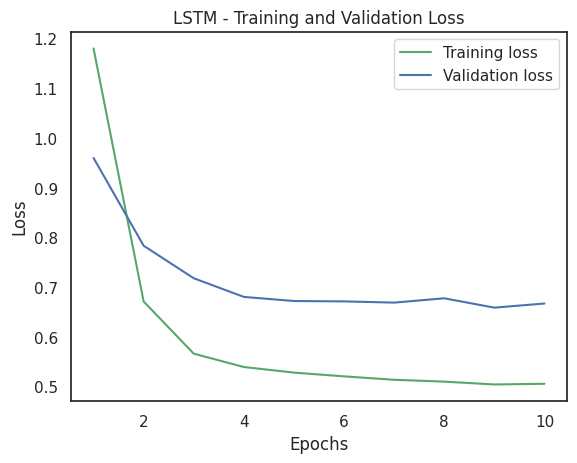

In [64]:
# Extract training and validation loss from the LSTM model's history
loss_train = lstm_history.history['loss']      # Training loss recorded during training
loss_val = lstm_history.history['val_loss']   # Validation loss recorded during training

# Define the range of epochs for plotting
epochs = range(1, 11)  # Epochs correspond to the number of training iterations (1 to 10)

# Plot the training and validation loss curves
plt.plot(epochs, loss_train, 'g', label='Training loss')   # Training loss in green
plt.plot(epochs, loss_val, 'b', label='Validation loss')  # Validation loss in blue

# Add title and labels to the plot
plt.title('LSTM - Training and Validation Loss')  # Plot title
plt.xlabel('Epochs')                       # Label for the x-axis (epochs)
plt.ylabel('Loss')                         # Label for the y-axis (loss)

# Display the legend to differentiate between training and validation loss
plt.legend()

# Show the plot
plt.show()

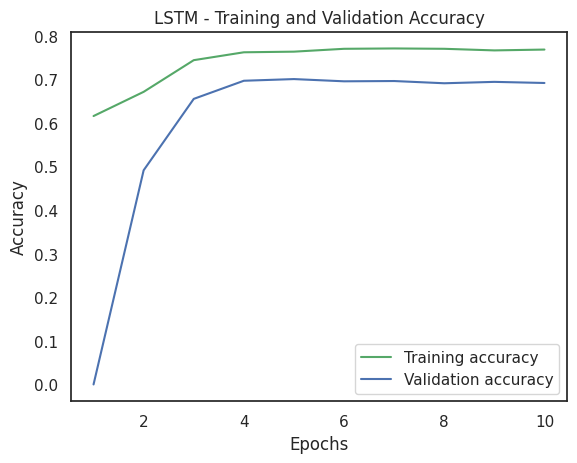

In [65]:
# Extract training and validation accuracy from the LSTM model's history
accuracy_train = lstm_history.history['accuracy']      # Training accuracy recorded during training
accuracy_val = lstm_history.history['val_accuracy']   # Validation accuracy recorded during training

# Define the range of epochs for plotting
epochs = range(1, 11)  # Epochs correspond to the number of training iterations (1 to 10)

# Plot the training and validation accuracy curves
plt.plot(epochs, accuracy_train, 'g', label='Training accuracy')   # Training accuracy in green
plt.plot(epochs, accuracy_val, 'b', label='Validation accuracy')  # Validation accuracy in blue

# Add title and labels to the plot
plt.title('LSTM - Training and Validation Accuracy')  # Plot title
plt.xlabel('Epochs')                           # Label for the x-axis (epochs)
plt.ylabel('Accuracy')                         # Label for the y-axis (accuracy)

# Display the legend to differentiate between training and validation accuracy
plt.legend()

# Show the plot
plt.show()

### Convolutional Neural Network (CNN)

In [66]:
# Set seeds for reproducibility
random.seed(15)
np.random.seed(15)
tf.random.set_seed(15)

# Initialize the Sequential model
cnn = tf.keras.models.Sequential()

# Add the first convolutional layer with 32 filters and ReLU activation
cnn.add(tf.keras.layers.Conv2D(filters=32, kernel_size=(3, 3), activation='relu',
                               padding='same', input_shape=(1, 19, 1)))

# Add a max-pooling layer to downsample the feature map
cnn.add(tf.keras.layers.MaxPooling2D(pool_size=(1, 2)))

# Flatten the output to a 1D vector
cnn.add(tf.keras.layers.Flatten())

# Add a dense layer with 128 neurons and ReLU activation
cnn.add(tf.keras.layers.Dense(units=128, activation='relu'))

# Add the output layer with 1 neuron and sigmoid activation for binary classification
cnn.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

# Compile the model with Adam optimizer, binary cross-entropy loss, and accuracy metric
cnn.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [67]:
# Train the CNN model with the training data
cnn_history = cnn.fit(
    x_train_res_reshaped_4d,  # Input data reshaped for CNN compatibility
    y_train_res,              # Corresponding labels for training data
    batch_size=32,            # Number of samples processed per training step
    epochs=50,                # Total number of passes through the entire dataset
    validation_split=0.2      # Fraction of data used for validation (20%)
)

Epoch 1/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.7160 - loss: 0.5322 - val_accuracy: 0.8469 - val_loss: 0.5016
Epoch 2/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7967 - loss: 0.4289 - val_accuracy: 0.8398 - val_loss: 0.4685
Epoch 3/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8083 - loss: 0.4074 - val_accuracy: 0.8360 - val_loss: 0.4563
Epoch 4/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8136 - loss: 0.3909 - val_accuracy: 0.8309 - val_loss: 0.4476
Epoch 5/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8269 - loss: 0.3754 - val_accuracy: 0.8322 - val_loss: 0.4363
Epoch 6/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8350 - loss: 0.3603 - val_accuracy: 0.8501 - val_loss: 0.4139
Epoch 7/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8454 - loss: 0.3464 - val_accuracy: 0.8610 - val_loss: 0.3846
Epoch 8/50
196/196 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8487 - loss: 0.3329 - val_accuracy: 0.

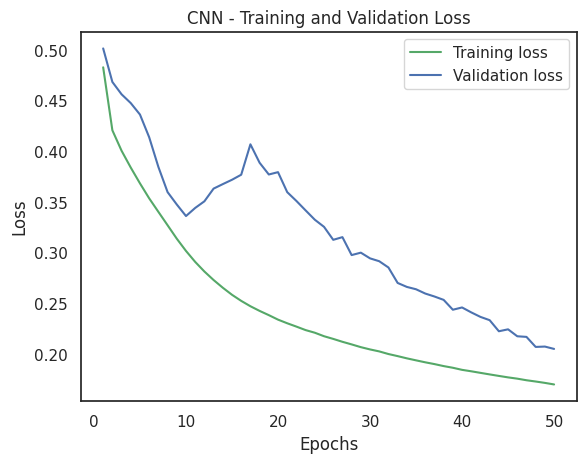

In [68]:
# Extract training and validation loss from the CNN model's history
loss_train = cnn_history.history['loss']      # Training loss recorded during training
loss_val = cnn_history.history['val_loss']   # Validation loss recorded during training

# Define the range of epochs for plotting
epochs = range(1, 51)  # Epochs correspond to the number of training iterations (1 to 50)

# Plot the training and validation loss curves
plt.plot(epochs, loss_train, 'g', label='Training loss')   # Training loss in green
plt.plot(epochs, loss_val, 'b', label='Validation loss')  # Validation loss in blue

# Add title and labels to the plot
plt.title('CNN - Training and Validation Loss')  # Plot title
plt.xlabel('Epochs')                           # Label for the x-axis (epochs)
plt.ylabel('Loss')                             # Label for the y-axis (loss)

# Display the legend to differentiate between training and validation loss
plt.legend()

# Show the plot
plt.show()

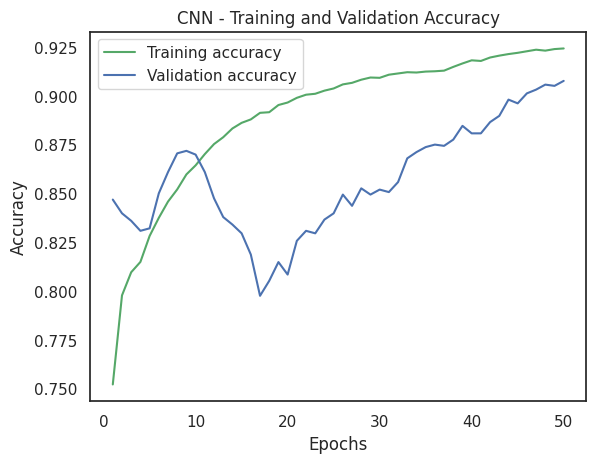

In [69]:
# Extract training and validation accuracy from the CNN model's history
accuracy_train = cnn_history.history['accuracy']      # Training accuracy recorded during training
accuracy_val = cnn_history.history['val_accuracy']   # Validation accuracy recorded during training

# Define the range of epochs for plotting
epochs = range(1, 51)  # Epochs correspond to the number of training iterations (1 to 50)

# Plot the training and validation accuracy curves
plt.plot(epochs, accuracy_train, 'g', label='Training accuracy')   # Training accuracy in green
plt.plot(epochs, accuracy_val, 'b', label='Validation accuracy')  # Validation accuracy in blue

# Add title and labels to the plot
plt.title('CNN - Training and Validation Accuracy')  # Plot title
plt.xlabel('Epochs')                               # Label for the x-axis (epochs)
plt.ylabel('Accuracy')                             # Label for the y-axis (accuracy)

# Display the legend to differentiate between training and validation accuracy
plt.legend()

# Show the plot
plt.show()

# 5) INTERPRET

## Model Comparison (RF vs XGBoost vs LSTM vs CNN)

### RF

In [70]:
# Initialize and fit the Random Forest model
classifier_rf = RandomForestClassifier(criterion='gini', n_estimators=100, random_state=0)  # Set up Random Forest
classifier_rf.fit(x_train_res, y_train_res)  # Train the model with reshaped training data

# Make predictions and calculate probabilities on the test set
y_pred_rf = classifier_rf.predict(x_test)  # Predict class labels on the test set
y_prob_rf = classifier_rf.predict_proba(x_test)[:, 1]  # Get predicted probabilities for the positive class on the test set

# Generate confusion matrix for the test set
cm_rf = confusion_matrix(y_test, y_pred_rf)  # Calculate confusion matrix to evaluate performance on the test set

              precision    recall  f1-score   support

           0       0.94      0.97      0.96       960
           1       0.18      0.11      0.14        62

    accuracy                           0.92      1022
   macro avg       0.56      0.54      0.55      1022
weighted avg       0.90      0.92      0.91      1022

ROC AUC score: 0.7950604838709676
Accuracy Score:  0.9158512720156555


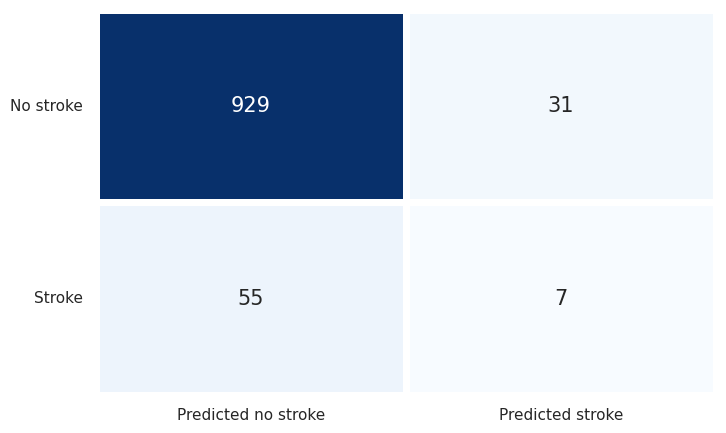

In [71]:
# Print classification report to evaluate Random Forest model performance with precision, recall, f1-score
print(classification_report(y_test, y_pred_rf))  # Using y_test and y_pred_rf for test set evaluation

# Print ROC AUC score for evaluating Random Forest model's ability to distinguish between classes
print(f'ROC AUC score: {roc_auc_score(y_test, y_prob_rf)}')  # Using y_test and y_prob_rf for test set evaluation

# Print accuracy score for overall performance measurement with Random Forest
print('Accuracy Score: ', accuracy_score(y_test, y_pred_rf))  # Using y_test and y_pred_rf for test set evaluation

# Visualize the confusion matrix as a heatmap for Random Forest model performance
plt.figure(figsize=(8, 5))  # Set figure size for the plot
sns.heatmap(cm_rf, cmap='Blues', annot=True, fmt='d', linewidths=5, cbar=False, annot_kws={'fontsize': 15},
            yticklabels=['No stroke', 'Stroke'], xticklabels=['Predicted no stroke', 'Predicted stroke'])
plt.yticks(rotation=0)  # Rotate y-axis labels
plt.show()  # Display the confusion matrix plot

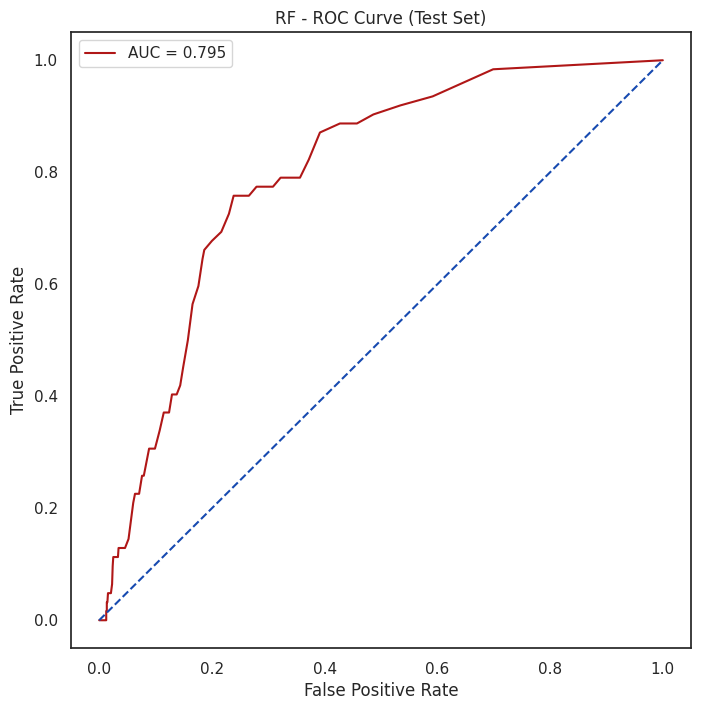

In [72]:
# Plot the ROC AUC curve for evaluating model performance across different thresholds on the test set
false_positive_rate_rf, true_positive_rate_rf, thresholds = roc_curve(y_test, y_prob_rf)  # Compute ROC curve values for test set
roc_auc_rf = auc(false_positive_rate_rf, true_positive_rate_rf)  # Calculate the AUC score for the ROC curve

# Set the theme for the plot using Seaborn
sns.set_theme(style='white')

# Initialize the plot with a specified figure size
plt.figure(figsize=(8, 8))

# Plot the ROC curve for the Random Forest model, showing AUC score in the legend
plt.plot(false_positive_rate_rf, true_positive_rate_rf, color='#b01717', label='AUC = %0.3f' % roc_auc_rf)

# Add a legend to the plot at the bottom-right corner
plt.legend(loc='lower right')

# Plot a diagonal line representing a random classifier (AUC = 0.5)
plt.plot([0, 1], [0, 1], linestyle='--', color='#174ab0')

# Set the axis limits for a tight fit around the curve
plt.axis('tight')

# Set the title, x-axis label, and y-axis label for the plot
plt.title('RF - ROC Curve (Test Set)')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')

# Display the plot with all elements
plt.legend()
plt.show()

### XGBoost

In [73]:
# Initialize and fit the XGBoost model
classifier_xgb = XGBClassifier(eval_metric='error', learning_rate=0.1)  # Set up XGBoost with error as evaluation metric and learning rate of 0.1
classifier_xgb.fit(x_train_res, y_train_res)  # Train the model with reshaped training data

# Make predictions and calculate probabilities on the test set
y_pred_xgb = classifier_xgb.predict(x_test)  # Predict class labels on the test set
y_prob_xgb = classifier_xgb.predict_proba(x_test)[:, 1]  # Get predicted probabilities for the positive class on the test set

# Generate confusion matrix for the test set
cm_xgb = confusion_matrix(y_test, y_pred_xgb)  # Calculate confusion matrix to evaluate performance on the test set

              precision    recall  f1-score   support

           0       0.95      0.95      0.95       960
           1       0.22      0.23      0.22        62

    accuracy                           0.90      1022
   macro avg       0.58      0.59      0.58      1022
weighted avg       0.91      0.90      0.90      1022

ROC AUC score: 0.7954805107526881
Accuracy Score:  0.9031311154598826


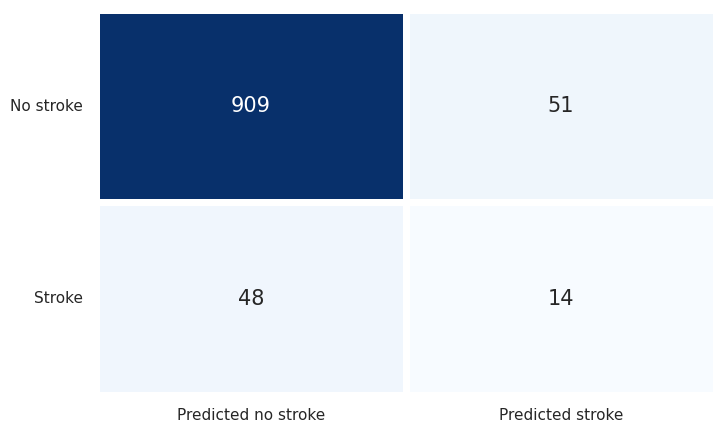

In [74]:
# Print classification report to evaluate XGBoost model performance with precision, recall, f1-score
print(classification_report(y_test, y_pred_xgb))  # Using y_test and y_pred_xgb for test set evaluation

# Print ROC AUC score for evaluating XGBoost model's ability to distinguish between classes
print(f'ROC AUC score: {roc_auc_score(y_test, y_prob_xgb)}')  # Using y_test and y_prob_xgb for test set evaluation

# Print accuracy score for overall performance measurement with XGBoost
print('Accuracy Score: ', accuracy_score(y_test, y_pred_xgb))  # Using y_test and y_pred_xgb for test set evaluation

# Visualize the confusion matrix as a heatmap for XGBoost model performance
plt.figure(figsize=(8, 5))  # Set figure size for the plot
sns.heatmap(cm_xgb, cmap='Blues', annot=True, fmt='d', linewidths=5, cbar=False, annot_kws={'fontsize': 15},
            yticklabels=['No stroke', 'Stroke'], xticklabels=['Predicted no stroke', 'Predicted stroke'])
plt.yticks(rotation=0)  # Rotate y-axis labels
plt.show()  # Display the confusion matrix plot

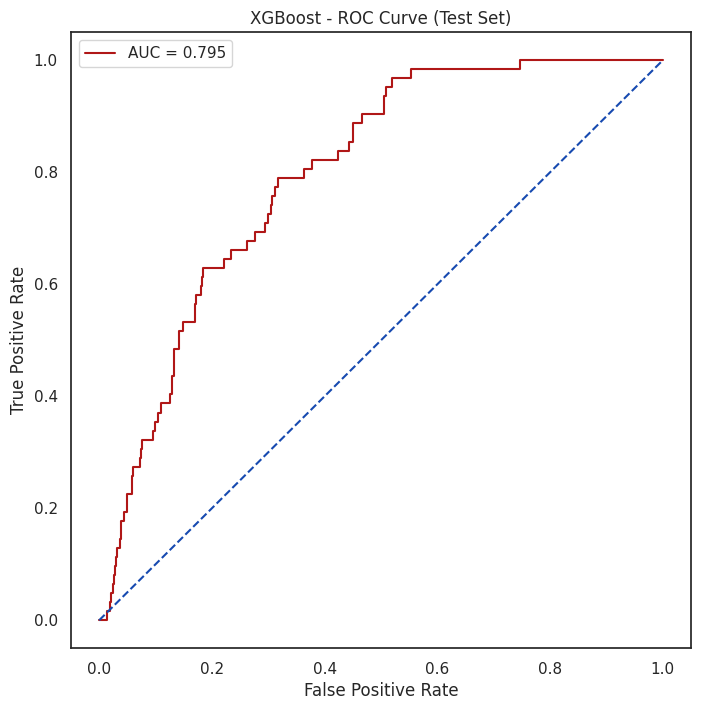

In [75]:
# Plot the ROC AUC curve for evaluating model performance across different thresholds on the test set
false_positive_rate_xgb, true_positive_rate_xgb, thresholds = roc_curve(y_test, y_prob_xgb)  # Compute ROC curve values for test set
roc_auc_xgb = auc(false_positive_rate_xgb, true_positive_rate_xgb)  # Calculate the AUC score for the ROC curve

# Set the theme for the plot using Seaborn
sns.set_theme(style='white')

# Initialize the plot with a specified figure size
plt.figure(figsize=(8, 8))

# Plot the ROC curve for the XGBoost model, showing AUC score in the legend
plt.plot(false_positive_rate_xgb, true_positive_rate_xgb, color='#b01717', label='AUC = %0.3f' % roc_auc_xgb)

# Add a legend to the plot at the bottom-right corner
plt.legend(loc='lower right')

# Plot a diagonal line representing a random classifier (AUC = 0.5)
plt.plot([0, 1], [0, 1], linestyle='--', color='#174ab0')

# Set the axis limits for a tight fit around the curve
plt.axis('tight')

# Set the title, x-axis label, and y-axis label for the plot
plt.title('XGBoost - ROC Curve (Test Set)')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')

# Display the plot with all elements
plt.legend()
plt.show()

### LSTM

In [76]:
# Reshape test data for LSTM input (samples, timesteps, features)
x_test_reshaped = x_test.reshape((x_test.shape[0], 1, x_test.shape[1]))

# Train the LSTM model with reshaped test data
lstm.fit(
    x_test_reshaped,  # Input data for LSTM
    y_test,           # Test labels
    batch_size=64,    # Batch size for training
    epochs=10,        # Number of epochs
)

Epoch 1/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8523 - loss: 0.3649
Epoch 2/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9318 - loss: 0.2565
Epoch 3/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9403 - loss: 0.2188
Epoch 4/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9403 - loss: 0.2169
Epoch 5/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9403 - loss: 0.2097
Epoch 6/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9403 - loss: 0.2057
Epoch 7/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9403 - loss: 0.2109
Epoch 8/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9423 - loss: 0.2035
Epoch 9/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9372 - loss: 0.2137
Epoch 10/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.9403 - loss: 0.2108


In [77]:
# Make predictions on the test set (class labels)
y_pred_lstm = lstm.predict(x_test_reshaped)  # Predict class labels on the test set using LSTM

# Get predicted probabilities for the positive class on the test set
y_prob_lstm = y_pred_lstm[:, 0]  # For binary classification, use the first column for the probability of the positive class

# Generate confusion matrix for the test set
cm_lstm = confusion_matrix(y_test, y_pred_lstm.argmax(axis=1))  # argmax to get class labels (0 or 1)

32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step


              precision    recall  f1-score   support

           0       0.94      1.00      0.97       960
           1       0.00      0.00      0.00        62

    accuracy                           0.94      1022
   macro avg       0.47      0.50      0.48      1022
weighted avg       0.88      0.94      0.91      1022

ROC AUC score: 0.8603998655913978
Accuracy Score:  0.9393346379647749


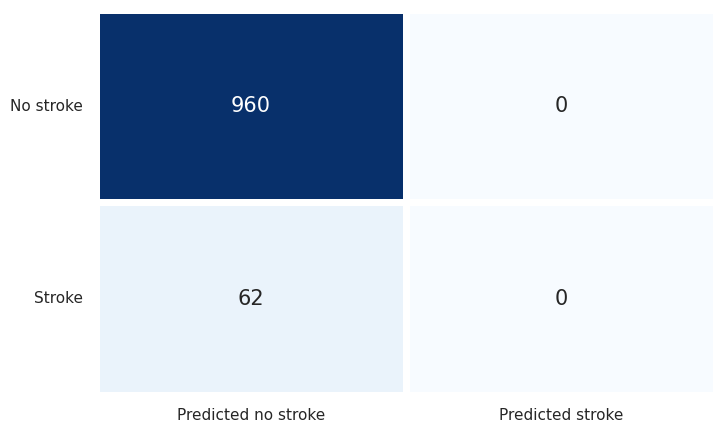

In [78]:
# Print classification report to evaluate LSTM model performance with precision, recall, f1-score
print(classification_report(y_test, y_pred_lstm.argmax(axis=1)))  # Using y_test and y_pred_lstm for test set evaluation

# Print ROC AUC score for evaluating LSTM model's ability to distinguish between classes
print(f'ROC AUC score: {roc_auc_score(y_test, y_prob_lstm)}')  # Using y_test and y_prob_lstm for test set evaluation

# Print accuracy score for overall performance measurement with LSTM
print('Accuracy Score: ', accuracy_score(y_test, y_pred_lstm.argmax(axis=1)))  # Using y_test and y_pred_lstm for test set evaluation

# Visualize the confusion matrix as a heatmap for LSTM model performance
plt.figure(figsize=(8, 5))  # Set figure size for the plot
sns.heatmap(cm_lstm, cmap='Blues', annot=True, fmt='d', linewidths=5, cbar=False, annot_kws={'fontsize': 15},
            yticklabels=['No stroke', 'Stroke'], xticklabels=['Predicted no stroke', 'Predicted stroke'])
plt.yticks(rotation=0)  # Rotate y-axis labels
plt.show()  # Display the confusion matrix plot

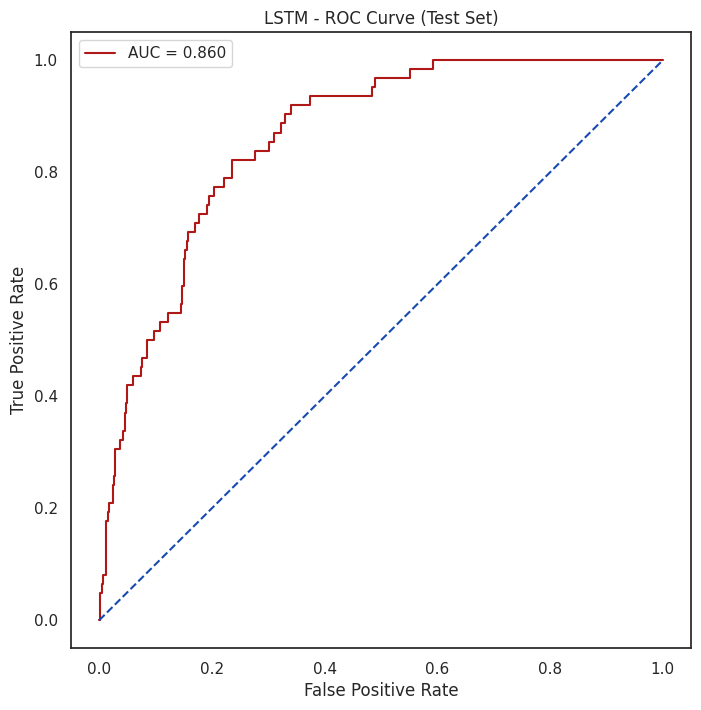

In [79]:
# Plot the ROC AUC curve for evaluating model performance across different thresholds on the test set
false_positive_rate_lstm, true_positive_rate_lstm, thresholds = roc_curve(y_test, y_prob_lstm)  # Compute ROC curve values for test set
roc_auc_lstm = auc(false_positive_rate_lstm, true_positive_rate_lstm)  # Calculate the AUC score for the ROC curve

# Set the theme for the plot using Seaborn
sns.set_theme(style='white')

# Initialize the plot with a specified figure size
plt.figure(figsize=(8, 8))

# Plot the ROC curve for the LSTM model, showing AUC score in the legend
plt.plot(false_positive_rate_lstm, true_positive_rate_lstm, color='#b01717', label='AUC = %0.3f' % roc_auc_lstm)

# Add a legend to the plot at the bottom-right corner
plt.legend(loc='lower right')

# Plot a diagonal line representing a random classifier (AUC = 0.5)
plt.plot([0, 1], [0, 1], linestyle='--', color='#174ab0')

# Set the axis limits for a tight fit around the curve
plt.axis('tight')

# Set the title, x-axis label, and y-axis label for the plot
plt.title('LSTM - ROC Curve (Test Set)')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')

# Display the plot with all elements
plt.legend()
plt.show()

### CNN

In [80]:
# Reshape test data for CNN input
x_test_cnn = x_test.reshape((x_test.shape[0], 1, x_test.shape[1], 1))  # Reshaped for data compatibility

# Train the CNN model with reshaped test data
cnn.fit(
    x_test_cnn,     # Input data for CNN
    y_test,         # Test labels
    batch_size=32,  # Batch size for training
    epochs=50,      # Number of epochs
)

Epoch 1/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9155 - loss: 0.2658
Epoch 2/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9200 - loss: 0.2293
Epoch 3/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9282 - loss: 0.2005
Epoch 4/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9327 - loss: 0.1848
Epoch 5/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9342 - loss: 0.1730
Epoch 6/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9352 - loss: 0.1639
Epoch 7/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9385 - loss: 0.1568
Epoch 8/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9400 - loss: 0.1511
Epoch 9/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9424 - loss: 0.1461
Epoch 10/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9422 - loss: 0.1421
Epoch 11/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9440 - loss: 0.1390
Epoch 12/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9459 - lo

In [81]:
# Make predictions on the test set (class labels) using the CNN
y_pred_cnn = cnn.predict(x_test_cnn)  # Predict class labels on the test set using CNN

# Get predicted probabilities for the positive class on the test set
y_prob_cnn = y_pred_cnn[:, 0]  # For binary classification, use the first column for the probability of the positive class

# Generate confusion matrix for the test set
cm_cnn = confusion_matrix(y_test, y_pred_cnn.argmax(axis=1))  # argmax to get class labels (0 or 1)

32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


              precision    recall  f1-score   support

           0       0.94      1.00      0.97       960
           1       0.00      0.00      0.00        62

    accuracy                           0.94      1022
   macro avg       0.47      0.50      0.48      1022
weighted avg       0.88      0.94      0.91      1022

ROC AUC score: 0.9890120967741935
Accuracy Score:  0.9393346379647749


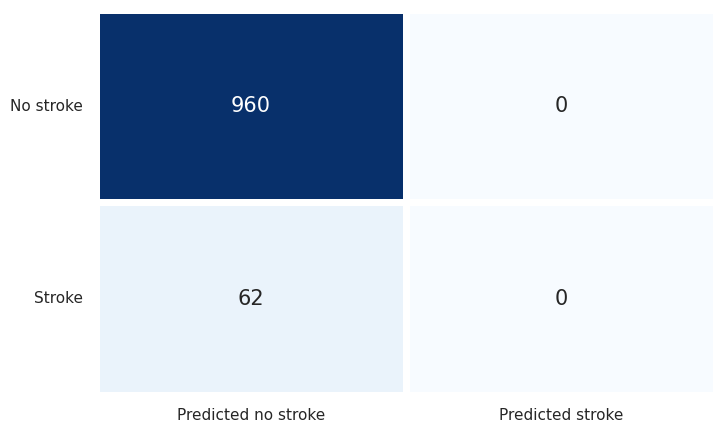

In [82]:
# Print classification report to evaluate CNN model performance with precision, recall, f1-score
print(classification_report(y_test, y_pred_cnn.argmax(axis=1)))  # Using y_test and y_pred_cnn for test set evaluation

# Print ROC AUC score for evaluating CNN model's ability to distinguish between classes
print(f'ROC AUC score: {roc_auc_score(y_test, y_prob_cnn)}')  # Using y_test and y_prob_cnn for test set evaluation

# Print accuracy score for overall performance measurement with CNN
print('Accuracy Score: ', accuracy_score(y_test, y_pred_cnn.argmax(axis=1)))  # Using y_test and y_pred_cnn for test set evaluation

# Visualize the confusion matrix as a heatmap for CNN model performance
plt.figure(figsize=(8, 5))  # Set figure size for the plot
sns.heatmap(cm_cnn, cmap='Blues', annot=True, fmt='d', linewidths=5, cbar=False, annot_kws={'fontsize': 15},
            yticklabels=['No stroke', 'Stroke'], xticklabels=['Predicted no stroke', 'Predicted stroke'])
plt.yticks(rotation=0)  # Rotate y-axis labels
plt.show()  # Display the confusion matrix plot

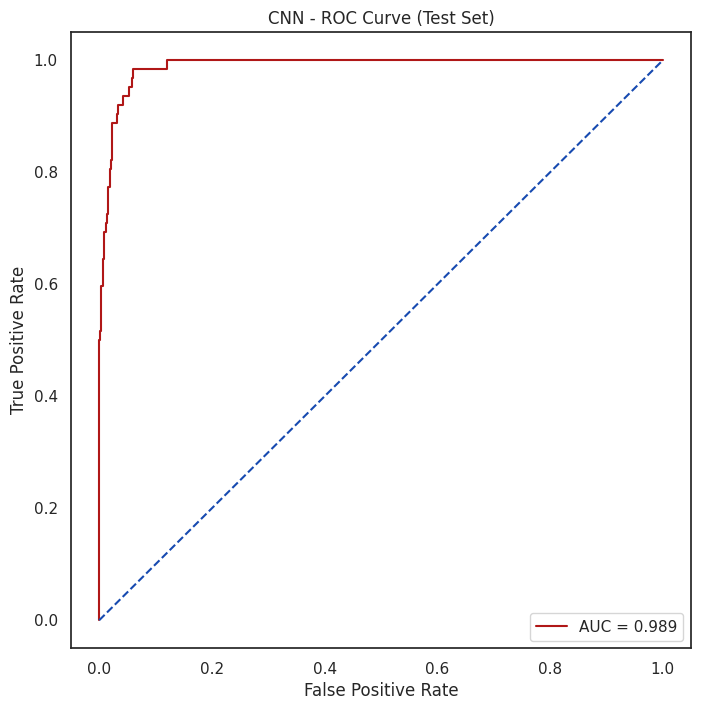

In [83]:
# Plot the ROC AUC curve for evaluating model performance across different thresholds on the test set
false_positive_rate_cnn, true_positive_rate_cnn, thresholds = roc_curve(y_test, y_prob_cnn)  # Compute ROC curve values for test set
roc_auc_cnn = auc(false_positive_rate_cnn, true_positive_rate_cnn)  # Calculate the AUC score for the ROC curve

# Set the theme for the plot using Seaborn
sns.set_theme(style='white')

# Initialize the plot with a specified figure size
plt.figure(figsize=(8, 8))

# Plot the ROC curve for the CNN model, showing AUC score in the legend
plt.plot(false_positive_rate_cnn, true_positive_rate_cnn, color='#b01717', label='AUC = %0.3f' % roc_auc_cnn)

# Add a legend to the plot at the bottom-right corner
plt.legend(loc='lower right')

# Plot a diagonal line representing a random classifier (AUC = 0.5)
plt.plot([0, 1], [0, 1], linestyle='--', color='#174ab0')

# Set the axis limits for a tight fit around the curve
plt.axis('tight')

# Set the title, x-axis label, and y-axis label for the plot
plt.title('CNN - ROC Curve (Test Set)')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')

# Display the plot with all elements
plt.legend()
plt.show()

## Special/Extra: Feature Importance Random Forest

### Diving into "Black Box" of Machine Learning

In [84]:
# Define feature names corresponding to the columns in the training dataset
feature_names = [
    'gender_female', 'gender_male', 'gender_other',
    'work_type_govt_job', 'work_type_never_worked', 'work_type_private',
    'work_type_self_employed', 'work_type_children', 'smoking_status_unknown',
    'smoking_status_formerly_smoked', 'smoking_status_never_smoked', 'smoking_status_smokes',
    'age', 'hypertension', 'heart_disease', 'ever_married',
    'residence_type', 'avg_glucose_level', 'bmi'
]

# Validate that the number of feature names matches the number of importances to avoid errors
if len(feature_names) != len(classifier_rf.feature_importances_):
    raise ValueError("Mismatch between feature names and feature importances length.")

# Create a DataFrame to pair feature names with their corresponding importance scores
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': classifier_rf.feature_importances_
})

# Sort the DataFrame by the importance scores in descending order for better readability
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Define a colormap with specific colors to highlight top features
colors = ["lightgray", "lightgray", "#0f4c81"]  # Top 3 features highlighted in dark blue
colormap = mcolors.LinearSegmentedColormap.from_list("custom_colormap", colors)

# Apply the custom colormap to the DataFrame for visual emphasis
styled_df = feature_importance_df.style.background_gradient(cmap=colormap)

# Display the styled DataFrame with highlighted feature importances
styled_df

,Feature,Importance
12,age,0.338817
18,bmi,0.136753
17,avg_glucose_level,0.134202
15,ever_married,0.082779
16,residence_type,0.075788
13,hypertension,0.032915
10,smoking_status_never_smoked,0.023469
0,gender_female,0.022107
5,work_type_private,0.021318
1,gender_male,0.020546


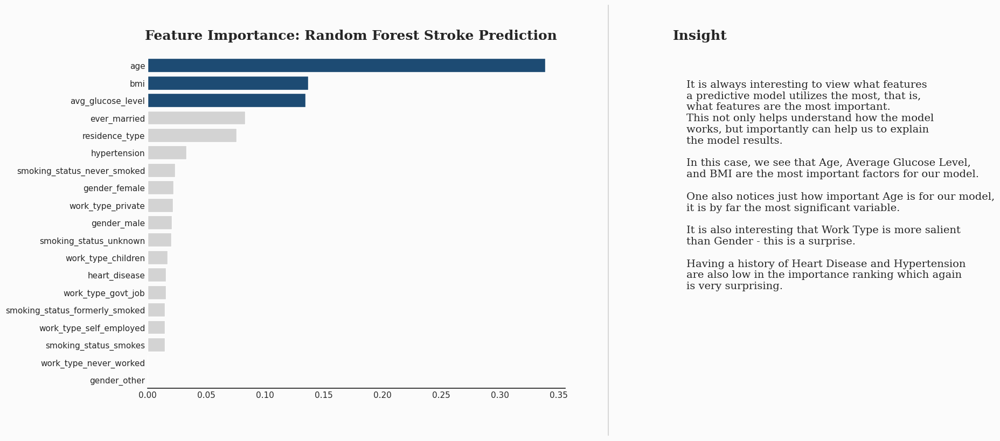

In [85]:
# Create DataFrame with feature names and importances
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': classifier_rf.feature_importances_
})

# Sort features by importance
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False).reset_index(drop=True)

# Visualization setup
background_color = "#fbfbfb"
fig, ax = plt.subplots(1, 1, figsize=(10, 8), facecolor=background_color)

# Color mapping: Highlight top 3 features
color_map = ['lightgray' for _ in range(len(feature_importance_df))]
color_map[0] = color_map[1] = color_map[2] = '#0f4c81'  # Highlight top 3 features

# Bar plot of feature importance
sns.barplot(
    data=feature_importance_df,
    x='Importance',
    y='Feature',
    ax=ax,
    palette=color_map
)

# Adjust plot aesthetics
ax.set_facecolor(background_color)
for spine in ['top', 'left', 'right']:
    ax.spines[spine].set_visible(False)

fig.text(
    0.12, 0.92,
    "Feature Importance: Random Forest Stroke Prediction",
    fontsize=18, fontweight='bold', fontfamily='serif'
)

fig.text(
    1.1, 0.92,
    "Insight",
    fontsize=18, fontweight='bold', fontfamily='serif'
)

fig.text(
    1.1, 0.315,
    '''
    It is always interesting to view what features
    a predictive model utilizes the most, that is,
    what features are the most important.
    This not only helps understand how the model
    works, but importantly can help us to explain
    the model results.

    In this case, we see that Age, Average Glucose Level,
    and BMI are the most important factors for our model.

    One also notices just how important Age is for our model,
    it is by far the most significant variable.

    It is also interesting that Work Type is more salient
    than Gender - this is a surprise.

    Having a history of Heart Disease and Hypertension
    are also low in the importance ranking which again
    is very surprising.
    ''',
    fontsize=14, fontweight='light', fontfamily='serif'
)

ax.tick_params(axis='both', which='both', length=0)

# Add vertical line
l1 = lines.Line2D(
    [0.98, 0.98],
    [0, 1],
    transform=fig.transFigure,
    figure=fig,
    color='black',
    lw=0.2
)
fig.lines.extend([l1])

plt.xlabel("", fontsize=12, fontweight='light', fontfamily='serif', loc='left')
plt.ylabel("", fontsize=12, fontweight='light', fontfamily='serif')

plt.show()

## Model Export and Deployment for Real-World Application

### Exporting the Best Model - Random Forest (RF), Encoders, and Scalers for Streamlit Deployment

In [86]:
# Save the trained random forest model to a .pkl file for later use
with open('classifier_rf_model.pkl', 'wb') as f:
    pickle.dump(classifier_rf, f)  # 'classifier_rf' is the trained random forest model

# Save the ColumnTransformer (including OneHotEncoder) and the two LabelEncoders (le1, le2) to a .pkl file
with open('preprocessor.pkl', 'wb') as f:
    pickle.dump((ct, le1, le2), f)  # Save ColumnTransformer, le1 (ever_married), and le2 (residence_type)

# Save the StandardScaler for feature scaling as well
with open('scaler.pkl', 'wb') as f:
    pickle.dump(sc, f)  # 'sc' is the StandardScaler object for scaling features